# NGC 628 (M74, UGC 1149)  2D

In [1]:
from IPython.display import HTML
from IPython.display import Image
import os
from PIL import Image as ImagePIL
import itertools

from scipy.interpolate import (
    LinearNDInterpolator, RectBivariateSpline,
    RegularGridInterpolator)
from scipy.ndimage import map_coordinates
# https://nbviewer.jupyter.org/github/pierre-haessig/stodynprog/blob/master/stodynprog/linear_interp_benchmark.ipynb

%pylab
%matplotlib inline
%run ../../utils/load_notebook.py

Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [2]:
from utils import *

importing Jupyter notebook from utils.ipynb
importing Jupyter notebook from instabilities.ipynb
Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [3]:
from photometry import *

importing Jupyter notebook from photometry.ipynb
Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [4]:
from instabilities import *

* [NED](https://ned.ipac.caltech.edu/cgi-bin/objsearch?objname=n628&extend=no&hconst=73&omegam=0.27&omegav=0.73&corr_z=1&out_csys=Equatorial&out_equinox=J2000.0&obj_sort=RA+or+Longitude&of=pre_text&zv_breaker=30000.0&list_limit=5&img_stamp=YES)
* [HYPERLEDA](http://leda.univ-lyon1.fr/ledacat.cgi?o=n628)

In [5]:
name = 'NGC628'
# gtype = 'SBm' #LEDA
incl = 7.0  #Leroy, Walter08
distance = 7.3 #Mpc, Walter08
scale = calc_scale(distance) #kpc/arcsec according to Noordermeer distance

data_path = '../../data/ngc628'
sin_i, cos_i = np.sin(incl*np.pi/180.), np.cos(incl*np.pi/180.)
print sin_i, cos_i, scale

0.121869343405 0.992546151641 0.0353914364198


Мотивация: результат из Leroy 2008

In [6]:
os.chdir(data_path)

# Источники, мотивация и картинки

[The Star Formation Efficiency in Nearby Galaxies: Measuring Where Gas Forms Stars Effectively](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2782/pdf) Leroy 2008

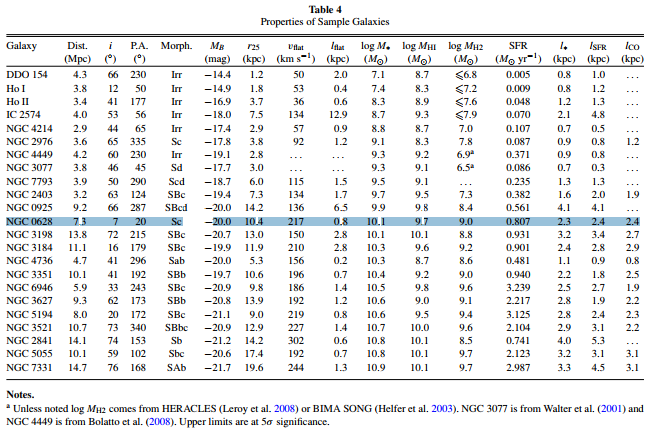

In [5]:
Image('Leroy2008_Table4.png', width=800)

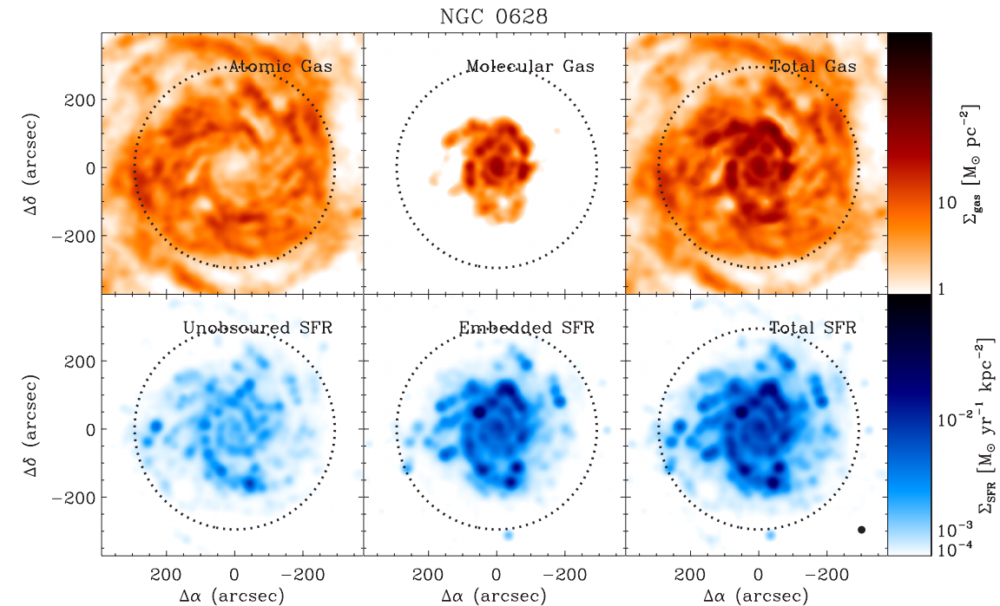

In [6]:
Image('Leroy2008_maps.png')

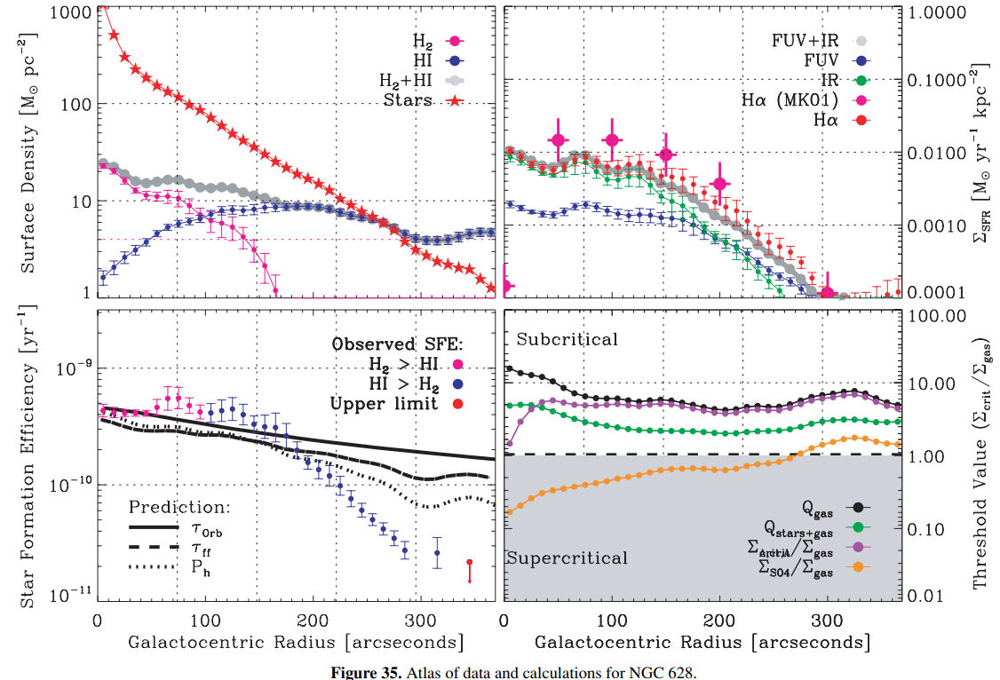

In [7]:
Image('Leroy2008_results.png')

[THINGS: THE H i NEARBY GALAXY SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf) Walter 2008

$I_{HI}, V_{HI}, \sigma_{HI}$

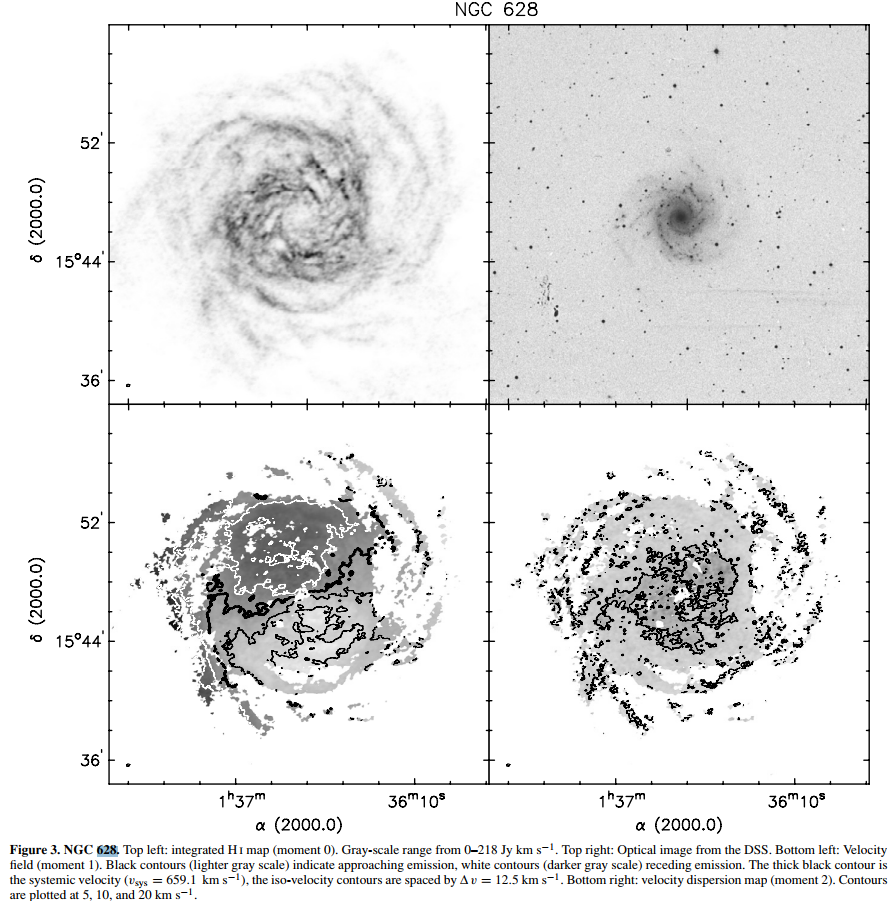

In [8]:
Image('THINGS_maps.png')

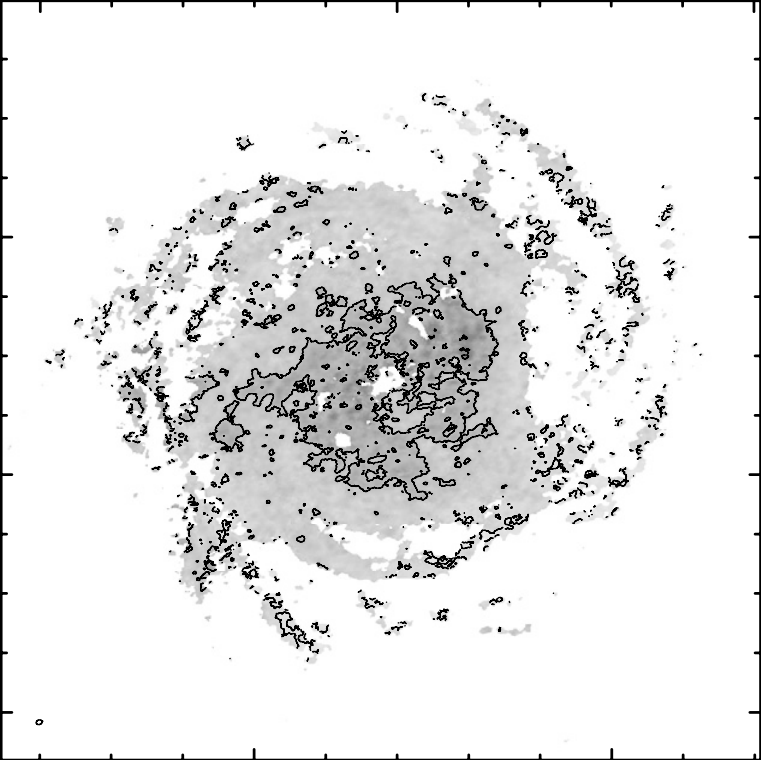

In [9]:
Image('THINGS_HI_disp.png')

[THE BIMA SURVEY OF NEARBY GALAXIES. I. THE RADIAL DISTRIBUTION OF CO EMISSION IN SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1086/323221/pdf)

$I_{CO}$

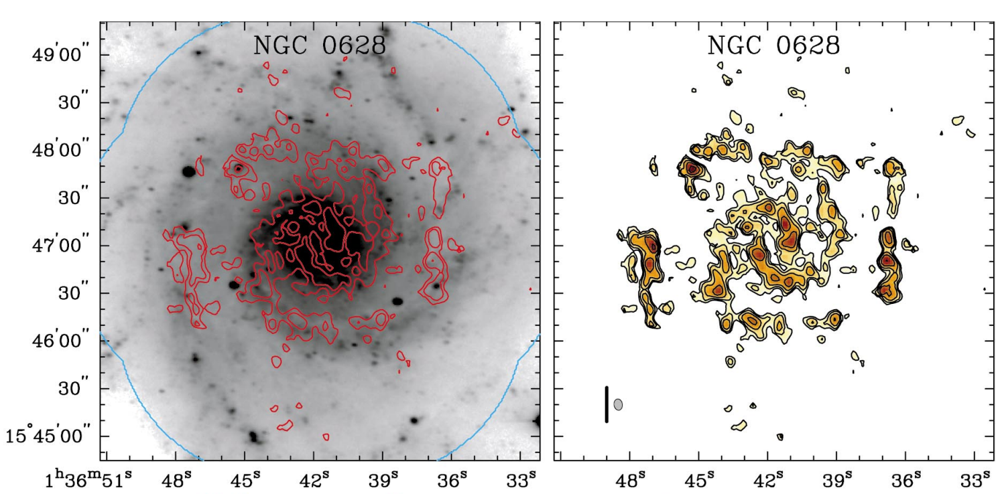

In [10]:
Image('BIMA_CO.png')

[THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): SURVEY DESIGN, DATA PROCESSING, AND SPECTRAL ANALYSIS METHODS](http://iopscience.iop.org/article/10.1088/0004-6256/145/5/138/pdf)

[THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): THE XCO GRADIENT IN NGC 628](http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf)

$V_*, \sigma_*$

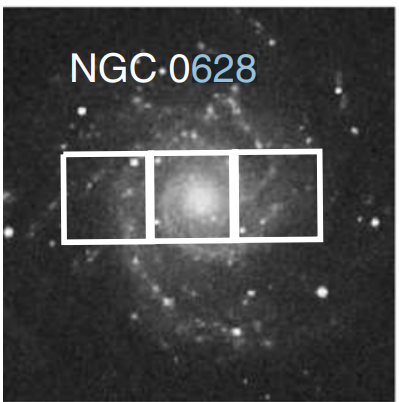

In [11]:
Image('VENGA_position.png')

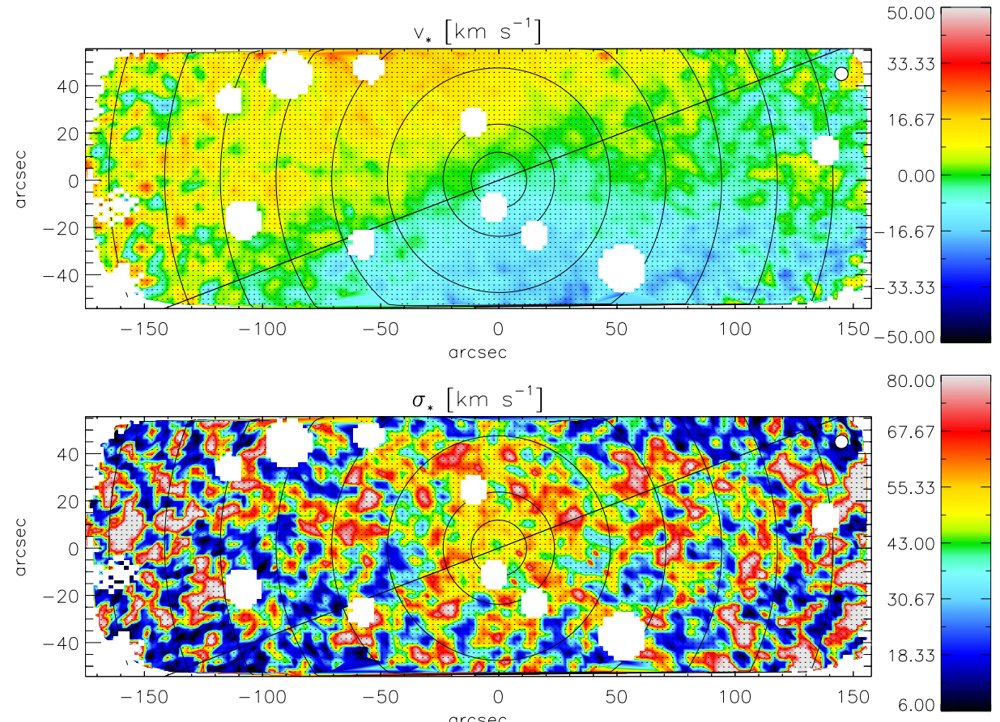

In [12]:
Image('VENGA_stellar_data.png')

[The JCMT Nearby Galaxies Legacy Survey – IV. Velocity dispersions in the molecular interstellar medium in spiral galaxies](https://ui.adsabs.harvard.edu/#abs/2011MNRAS.410.1409W/abstract)

$\sigma_{CO(3-2)}$

>CO J = 3–2 velocity dispersion for six galaxies which are not members of the Virgo cluster. (a) NGC 628. Contour levels are 2.5, 5 and 10 km s−1
and the colour scale peak is 15 km s−1.

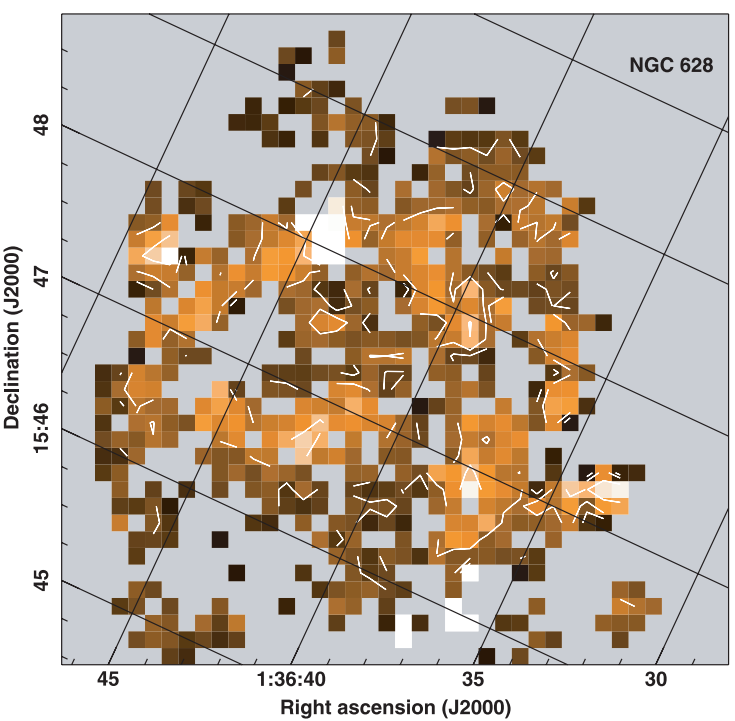

In [13]:
Image('JCMT_CO_disp.png')

[COMPARING C ii, H i, AND CO DYNAMICS OF NEARBY GALAXIES](https://arxiv.org/pdf/1604.08777.pdf)

есть карта скоростей CII, HI и CO

[CO(J = 3 − 2) On-the-fly Mapping of the Nearby Spiral Galaxies NGC 628 and NGC 7793: Spatially-resolved CO(J = 3 − 2) Star-formation Law](https://arxiv.org/pdf/1512.04159.pdf)

$I_{CO(3-2)}$

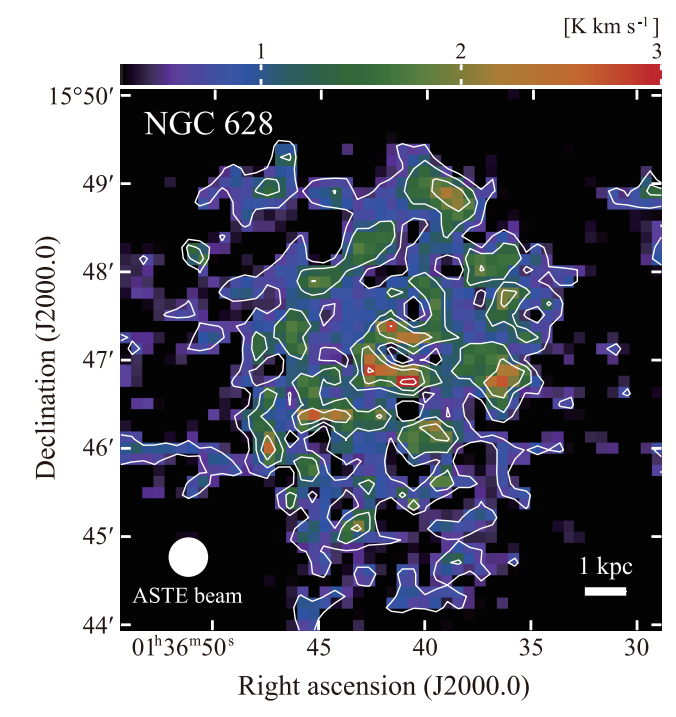

In [14]:
Image('CO_3_2_intens.png')

[HI AND CO VELOCITY DISPERSIONS IN NEARBY GALAXIES](https://arxiv.org/pdf/1511.06006.pdf) 

радиальные профили $\sigma_{HI}, \sigma_{CO}$, можно использовать для проверки

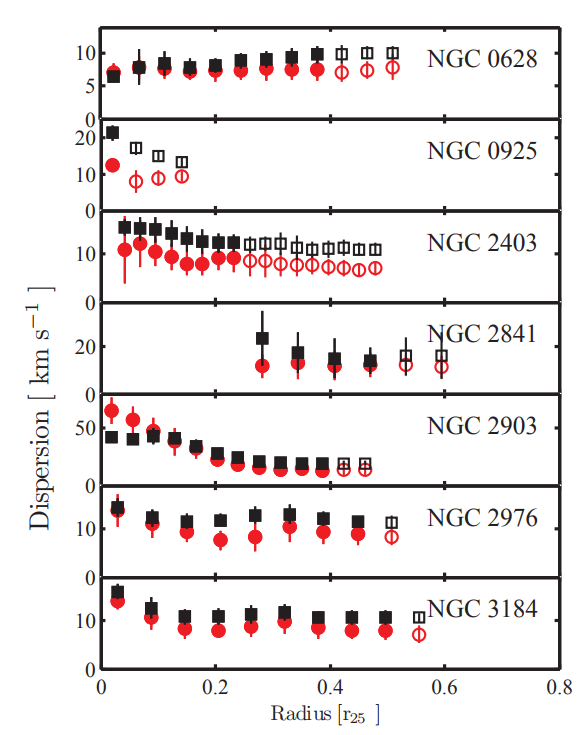

In [15]:
Image('Mogotsi_gas_disp.png')

[HERACLES: THE HERA CO LINE EXTRAGALACTIC SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/137/6/4670/pdf) Leroy 2009

есть карта $I_{CO(2-1)}$

[SCALING RELATIONS OF THE PROPERTIES FOR CO RESOLVED STRUCTURES IN NEARBY SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf) Leroy 2015

$\Sigma_{H_2}, \Sigma_{SFR}$ (правда только для верхней части галактики судя по всему)

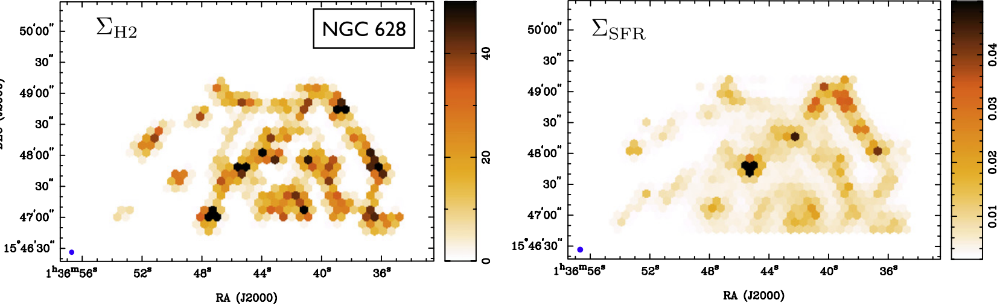

In [16]:
Image('H2_SFR_binning.png')

[THE CO-TO-H2 CONVERSION FACTOR AND DUST-TO-GAS RATIO ON KILOPARSEC SCALES IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/777/1/5/pdf)

Данные по $\alpha_{CO}, \Sigma_{dust}$

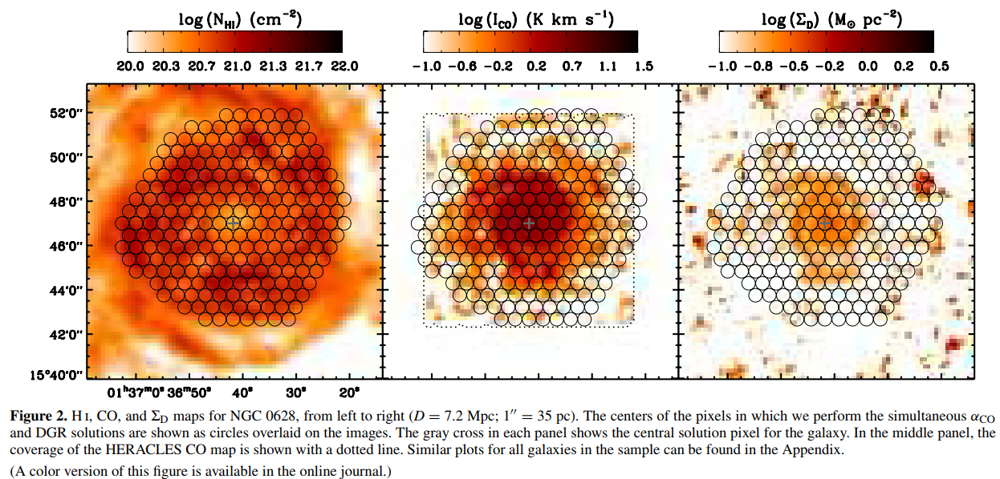

In [17]:
Image('dust_map.png')

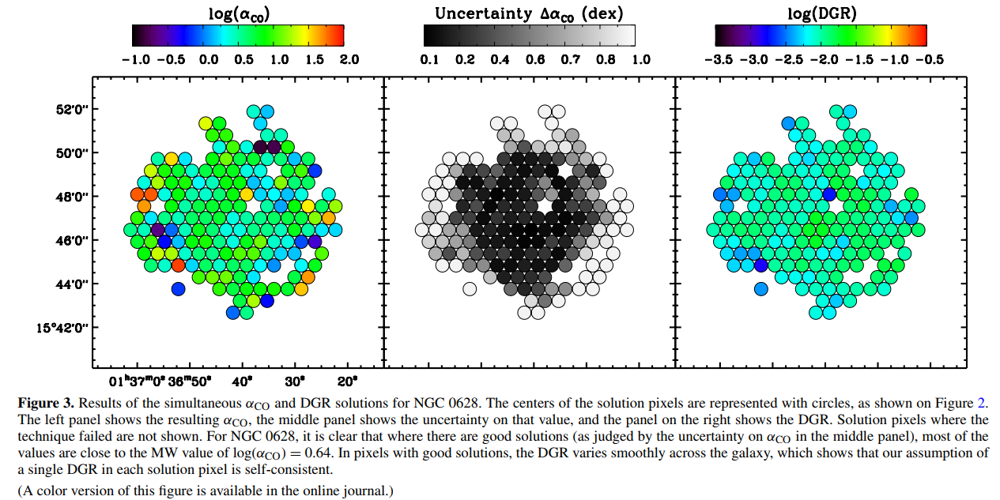

In [18]:
Image('alpha_CO_map.png')

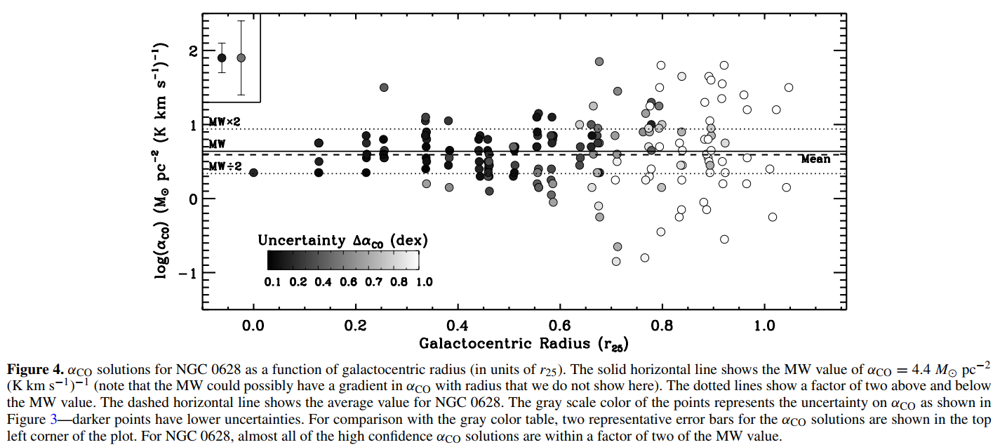

In [7]:
Image('alpha_CO_variations.png')[Late-type galaxies observed with SAURON: two-dimensional stellar and emission-line kinematics of 18 spirals](https://academic.oup.com/mnras/article/367/1/46/1020614/Late-type-galaxies-observed-with-SAURON-two)
Image('SAURON_view.png')
Image('SAURON_star_maps.png')
[The inner mass distribution of late-type spiral galaxies from SAURON stellar kinematic maps](https://arxiv.org/pdf/1609.08700.pdf)
Image('SAURON_maps2.png')
Есть кривая вращения, но как-то уж очень странно извлеченная.
Image('SAURON_data3.png')

[Hα kinematics of the SINGS nearby galaxies survey – I](http://adsabs.harvard.edu/abs/2006MNRAS.367..469D)
Image('Halpha_SINGS.png')

http://iopscience.iop.org/article/10.1088/0004-6256/141/1/24/pdf Vollmer Leroy 2011 - турбулентная модель
Image('Leroy2011_rotcurve.png')

[THE HIERARCHICAL DISTRIBUTION OF THE YOUNG STELLAR CLUSTERS IN SIX LOCAL STAR FORMING GALAXIES](https://arxiv.org/pdf/1704.06321.pdf)

[PLANETARY NEBULAE IN FACE-ON SPIRAL GALAXIES. III. PLANETARY NEBULA KINEMATICS AND DISK MASS](http://iopscience.iop.org/article/10.1088/0004-637X/705/2/1686/pdf)

TODO: есть кривая вращения
Image('stas_data1.png')
Image('stas_data2.png')
Image('rotcurve2.png')


[THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): THE XCO GRADIENT IN NGC 628](http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf)

Данные по $SFR$, $I_{CO}$ из HERACLES, BIMA, CARMS, карта металличности, изучение $X_{CO}$

>We caution against adopting a single XCO value when large changes in gas surface density
or metallicity are present.

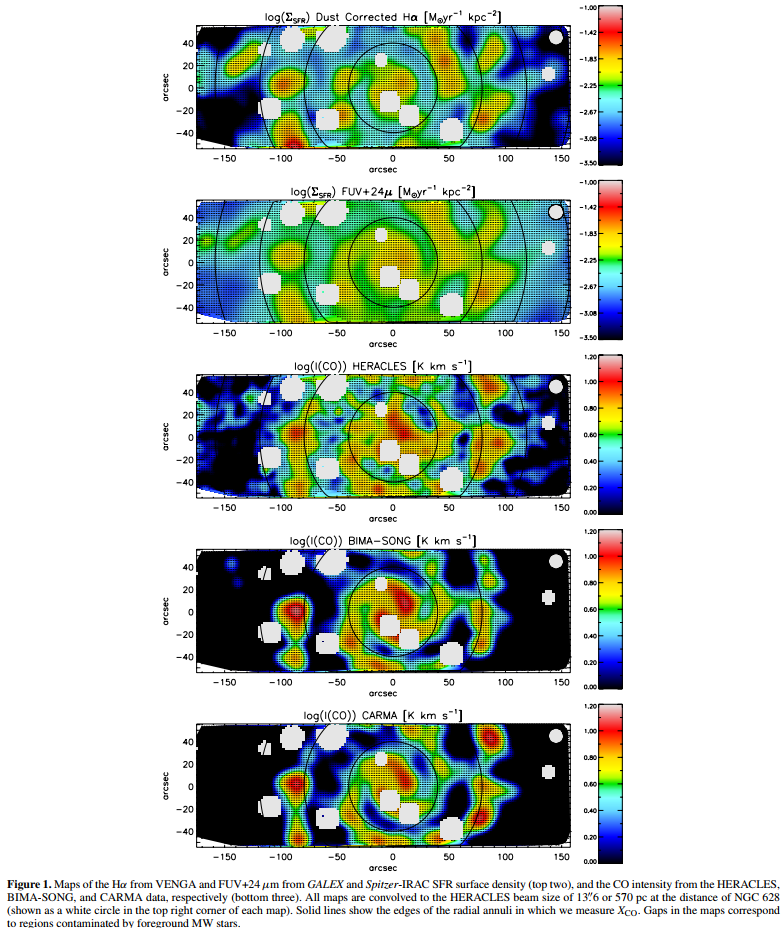

In [19]:
Image('VENGA_CO_SFR.png')

[DISCOVERY OF RECENT STAR FORMATION IN THE EXTREME OUTER REGIONS OF DISK GALAXIES](http://iopscience.iop.org/article/10.1086/311626/pdf) - $H_{\alpha}$ картинка

[The JCMT Nearby Galaxies Legacy Survey. VII. Hα imaging and massive star formation properties](https://arxiv.org/pdf/1203.0001.pdf)

картинка $H_{\alpha}$

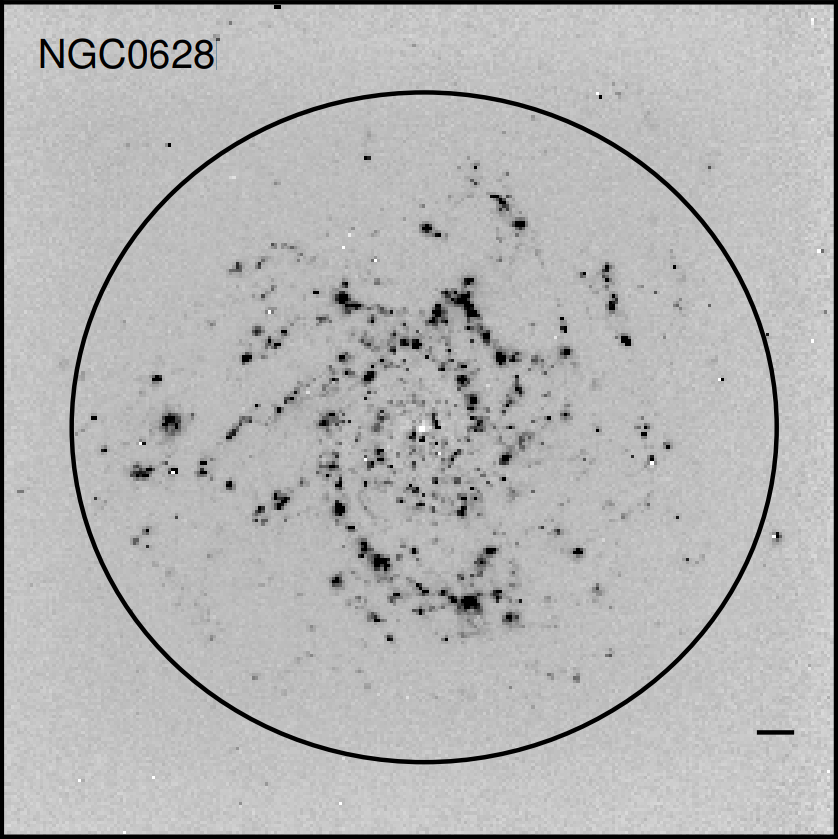

In [21]:
Image('JCMT_H_alpha.png', width=500)

[The Westerbork SINGS survey III. Global magnetic field topology](https://www.aanda.org/articles/aa/pdf/2010/06/aa13375-09.pdf)

В случае, если нас заинтересует - есть данные по магнитному полю

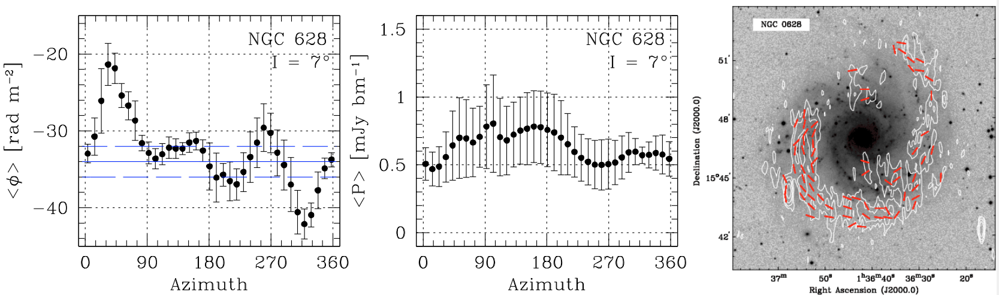

In [22]:
Image('SINGS_magnetic.png')

[Hα Kinematics of the SINGS Nearby Galaxies Survey](https://arxiv.org/pdf/astro-ph/0601376.pdf) - $H_{\alpha}$ кривая вращения

[The JCMT Nearby Galaxies Legacy Survey – VIII. CO data and the LCO(3−2)–LFIR correlation in the SINGS sample](https://oup.silverchair-cdn.com/oup/backfile/Content_public/Journal/mnras/424/4/10.1111_j.1365-2966.2012.21453.x/1/424-4-3050.pdf?Expires=1504015928&Signature=LkroryIoCFcC7KwEtI73WJ5DKK3qzRrM56WiybgKCpcejAtQaaqbqzVcZkEUnYo3u3M8-nsM4AWNjXtjV3nJHRi5FU1dqAQ4VqritmCvXw1hbstOSTNWjsZzPNiD9TAehKbLPAblc6EFF0338NS7vyGp8UUNWq95zIeqA0FIjM4UxtotKVyOfjsMruYY4PjjJCbF8ItUsFFXelMiri2JlKUuVS6Lz2pmfxj8UntbHhqzVBawtdWD4IV0BTLPHN6oB58hwZ~3lVXurPXOkm1C9a-GBaZCQgEucyDCTjIPoJJWnE1fY7z5ouaRL6BsJsdHEe3XTr9F9uW387tcailomQ__&Key-Pair-Id=APKAIUCZBIA4LVPAVW3Q) - есть карта $I_{CO(3-2)}, V_{CO(3-2)}$

Фотометрия

* Heidt 2001 https://www.aanda.org/articles/aa/pdf/2001/10/aa10227.pdf - балдж 13-20 arcsec
* http://iopscience.iop.org/article/10.1088/0004-6256/142/1/16/pdf - вроде порядка 15

https://arxiv.org/pdf/1506.01653.pdf $M_*,SFR, extinction$ maps

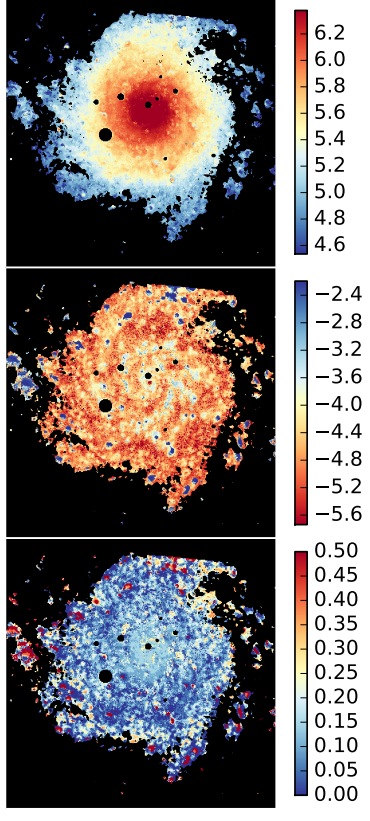

In [6]:
Image('Sorba2015_maps.png')

SPITZER изображение http://www.spitzer.caltech.edu/images/2257-sig06-018c-NASA-s-Spitzer-Space-Telescope-View-of-M74

На заглавной https://guaix.fis.ucm.es/sings есть куча картинок NGC628 в полосах FUV 1528 A,	NUV   2271 A,	B   0.45 μm,	V   0.55 μm,	R   0.66 μm,	I   0.81 μm, IRAC1   3.6 μm,
	IRAC2   4.5 μm,IRAC3   5.8 μm,	IRAC4   8.0 μm,	MIPS1   24 μm,	MIPS2   70 μm. 

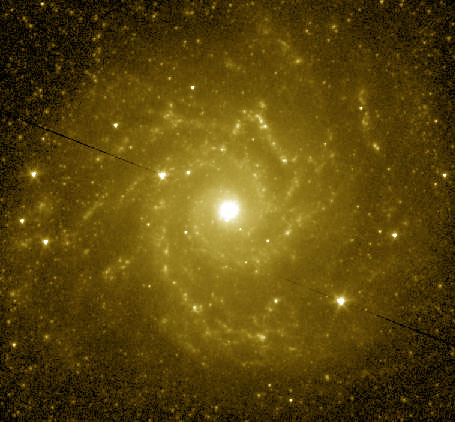

In [7]:
Image('https://guaix.fis.ucm.es/sites/default/files/images/science/sings/ngc0628irac1_color.jpg')

$S^4G$  http://www.oulu.fi/astronomy/S4G_PIPELINE4/MAIN/decomp0053.html#entry0003

[Late-type galaxies observed with SAURON: two-dimensional stellar and emission-line kinematics of 18 spirals](https://academic.oup.com/mnras/article/367/1/46/1020614/Late-type-galaxies-observed-with-SAURON-two)

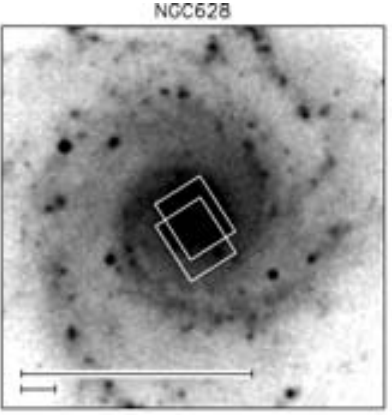

In [10]:
Image('SAURON_view.png')

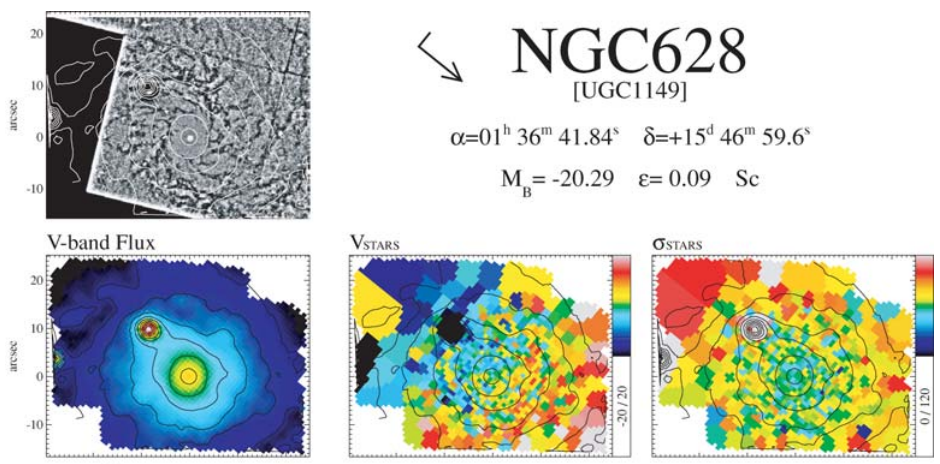

In [11]:
Image('SAURON_star_maps.png')

[The inner mass distribution of late-type spiral galaxies from SAURON stellar kinematic maps](https://arxiv.org/pdf/1609.08700.pdf)

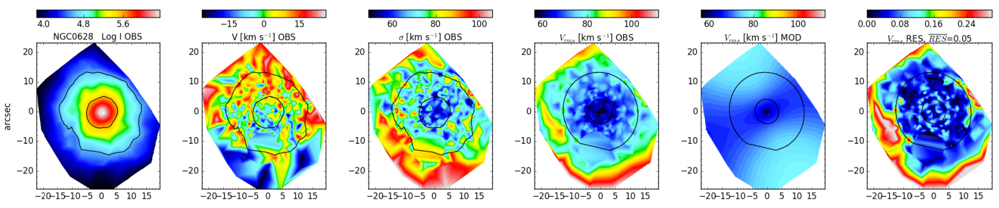

In [13]:
Image('SAURON_maps2.png')

Есть кривая вращения, но как-то уж очень странно извлеченная.

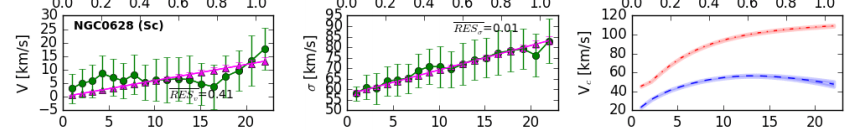

In [14]:
Image('SAURON_data3.png')

[Hα kinematics of the SINGS nearby galaxies survey – I](http://adsabs.harvard.edu/abs/2006MNRAS.367..469D)

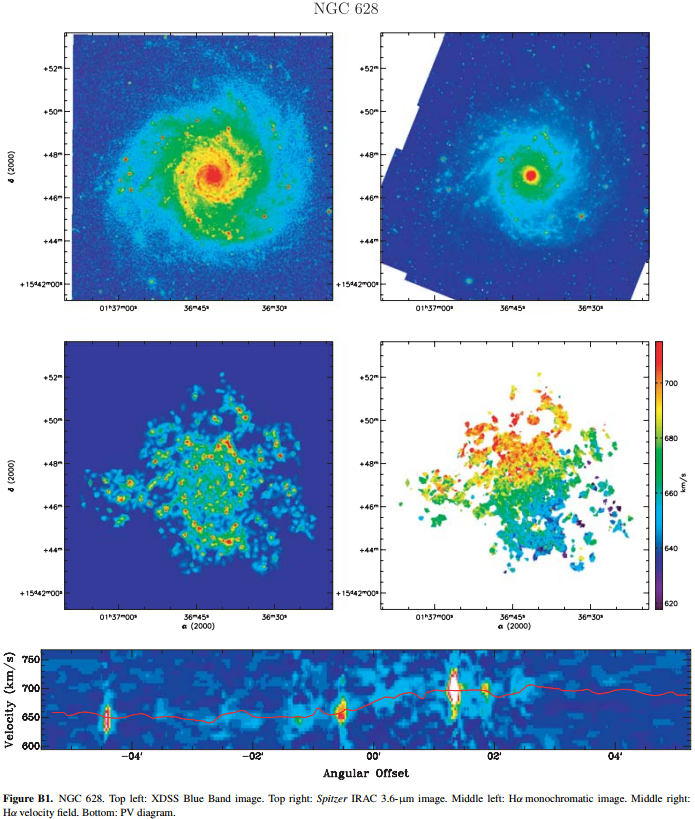

In [12]:
Image('Halpha_SINGS.png')

http://iopscience.iop.org/article/10.1088/0004-6256/141/1/24/pdf Vollmer Leroy 2011 - турбулентная модель

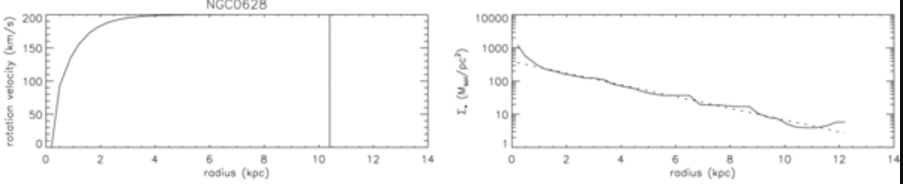

In [65]:
Image('Leroy2011_rotcurve.png')

[THE HIERARCHICAL DISTRIBUTION OF THE YOUNG STELLAR CLUSTERS IN SIX LOCAL STAR FORMING GALAXIES](https://arxiv.org/pdf/1704.06321.pdf)

[PLANETARY NEBULAE IN FACE-ON SPIRAL GALAXIES. III. PLANETARY NEBULA KINEMATICS AND DISK MASS](http://iopscience.iop.org/article/10.1088/0004-637X/705/2/1686/pdf)

TODO: есть кривая вращения

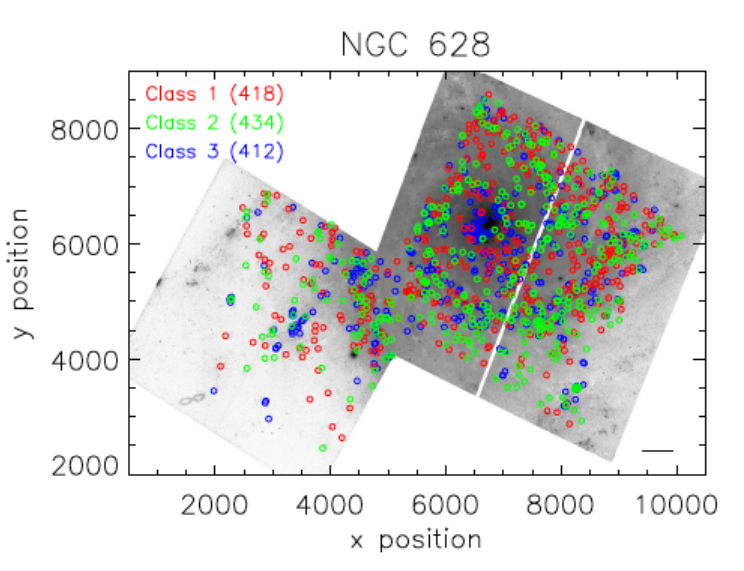

In [66]:
Image('stas_data1.png')

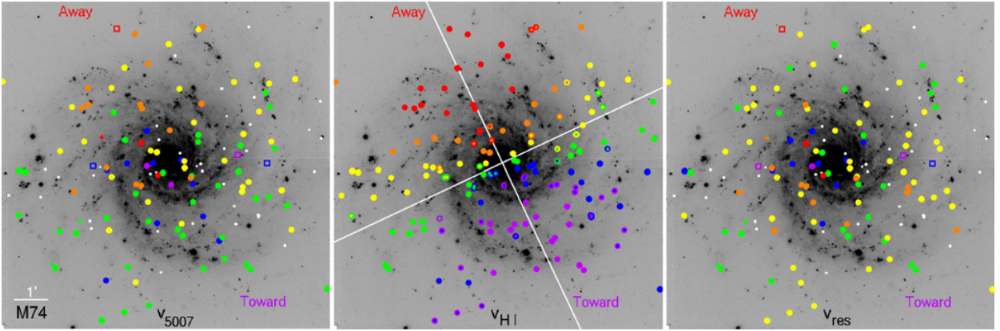

In [67]:
Image('stas_data2.png')

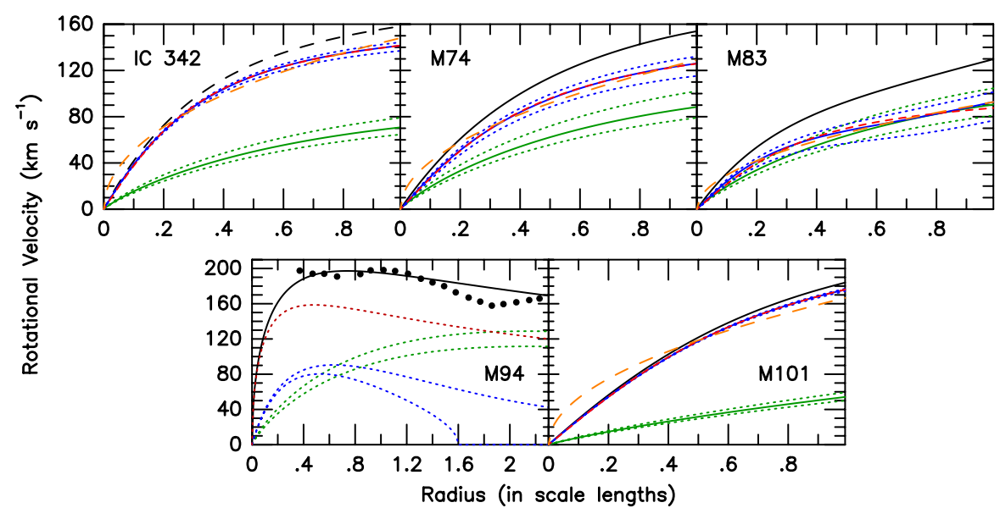

In [68]:
Image('rotcurve2.png')

# THINGS расстояния

https://physics.stackexchange.com/questions/224950/how-can-i-convert-right-ascension-and-declination-to-distances

In [58]:
from astropy.coordinates import SkyCoord
from astropy import units as u

In [59]:
c = SkyCoord('00h42.5m', '+41d12m')
c2 = SkyCoord('00h43.5m', '+41d13m')
c.separation(c2)

<Angle 0.18881672122371843 deg>

In [61]:
x = c.separation(c2)
print type(x)
print x.arcsec

<class 'astropy.coordinates.angles.Angle'>
679.740196405


In [97]:
18/36.

0.5

In [102]:
23/29.

0.7931034482758621

In [103]:
22./29 * 2

1.5172413793103448

In [118]:
lb = SkyCoord(ra='01h37m35s', dec='+15d34.5m')
rb = SkyCoord('01h35m49.5s', '+15d34.5m')

lu = SkyCoord('01h37m35s', '+16d00m')
ru = SkyCoord('01h35m49.5s', '+16d00m')

In [119]:
print lb.separation(rb).arcsec
print lu.separation(ru).arcsec

1524.39003535
1521.19635036


In [126]:
def pix_to_coordinates(xpix, ypix):
    xrange_ = lb.data.lon.deg + (rb.data.lon.deg-lb.data.lon.deg)/1024. * (xpix)
    yrange_ = lb.data.lat.deg + (lu.data.lat.deg-lb.data.lat.deg)/1024. * (ypix)
    return SkyCoord(ra='{}deg'.format(xrange_), dec='{}deg'.format(yrange_))

In [136]:
pix_to_coordinates(512,512).ra.hms

hms_tuple(h=1.0, m=36.0, s=42.250000008001223)

In [137]:
dist = np.zeros((1024,1024))

In [ ]:
%%time
# 1h34min
center = pix_to_coordinates(512,512)
for xpix in range(1024):
    print xpix
    for ypix in range(1024):
        dist[xpix][ypix] = center.separation(pix_to_coordinates(xpix,ypix)).arcsec

In [188]:
np.save('dist_map.npy', dist)

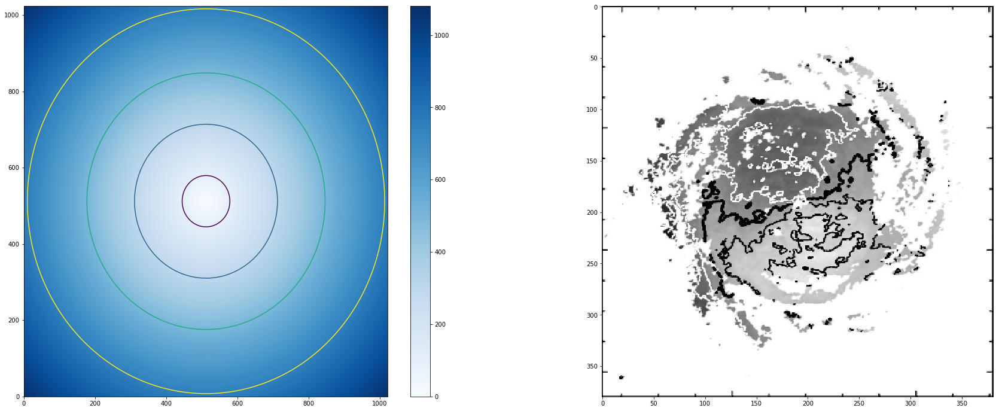

In [192]:
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, dist, cmap=cm.Blues)
# quadmesh.set_clim(vmin=-77., vmax=77.)

# CS = plt.contour(X, Y, Z, levels=[-25., -12.5, 0., 12.5, 25.])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
quadmesh.cmap.set_under('white')

CS = plt.contour(X, Y, dist, levels=[100, 300, 500, 750])

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('Leroy_HI_vel.png'))

# Плотность $\Sigma_{HI}$

$$\Sigma_{HI} [M_{sun} pc^{-2}] = 0.020 \cos i \times I_{21cm} [K km s^{-1}]$$
из https://arxiv.org/pdf/1609.03179.pdf $$\Sigma_{HI}[M_{sun} {pc}^{-2}] = 8840\times\frac{F_{HI}[Jy / beam \times km/s]}{bmaj\times bmin [arcsec]},$$
where the bmaj and bmin are the major and minor axis size of the beam, respectively. FHI is the flux detected across all velocity channels.

Чтобы перевести в кельвины в Walter написана формула
$$T[K] = 6.07\times 10^5\times S[Jy beam^{-1}]/(B_{maj}\times B_{min}),$$ где $B_{maj},B_{min}$ - размеры бима в секундах

Т.к. мы использовал ```NA``` данные - размеры бима 11.88 и 9.30 arcsec

In [34]:
6.07*2*1000*cos_i*200/(11.88*9.30*calc_scale(distance)**2 * 1000**2)

17.414203847679726

Не знаю почему, но похоже надо переводить beam в пк.

In [8]:
f = lambda l: 6.07*2*1000*cos_i*l/(11.88*9.30*calc_scale(distance)**2 * 1000**2)
Z1 = f(Z)

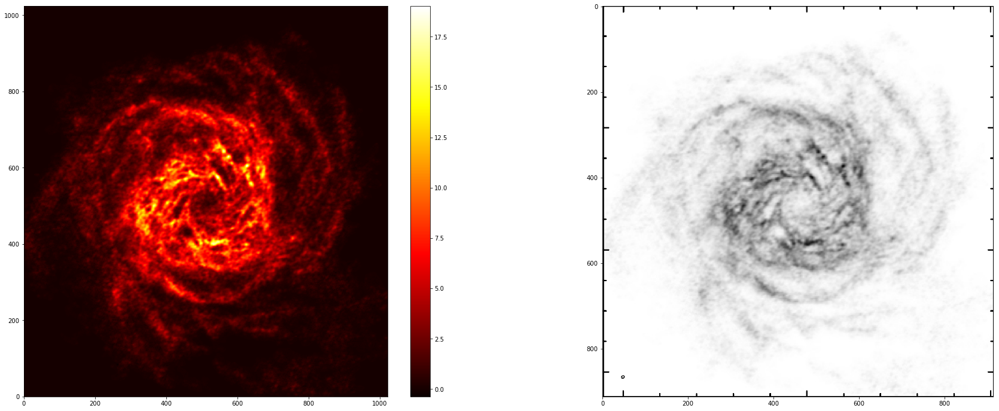

In [9]:
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z1, cmap=cm.hot)
# quadmesh.set_clim(vmin=10., vmax=17.5)

# CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
quadmesh.cmap.set_under('white')

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('THINGS_HI_flux.png'))

In [10]:
Sigma_HI = Z1

In [41]:
np.save('Sigma_HI.npy', Sigma_HI)

Проверка

In [140]:
HI_raw = ImagePIL.open('Leroy_HI_scaled.png')

In [143]:
fdata = list(HI_raw.getdata())

In [144]:
HI_raw.height, HI_raw.width

(861, 862)

In [147]:
disp_colorbar = ImagePIL.open('Leroy_HI_colorbar.png')

In [148]:
disp_colorbar.width, disp_colorbar.height

(334, 862)

In [149]:
disp_colorbar = np.array(list(disp_colorbar.getdata())).reshape(862, 334, 4)

In [151]:
disp_colorbar = disp_colorbar[:, 10:11, :]

In [152]:
disp_colorbar = disp_colorbar.reshape(862, 4)

In [159]:
# 305 px = 9 km/s
305./9

33.888888888888886

In [160]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    argmin = np.argmin(np.linalg.norm(disp_colorbar - color, axis=1))
    return np.round(1. + (862-argmin)/33.89)

In [161]:
color_to_level((239, 85, 0, 255))

10.0

In [162]:
color_to_level((255, 255, 255, 255))

1.0

In [163]:
color_to_level((1, 0, 0, 255))

26.0

In [166]:
X,Y = np.meshgrid(np.arange(0.,862,1), np.arange(0.,861,1))
Z = np.array(fdata).reshape(861, 862, 4)

Z = np.apply_along_axis(color_to_level, 2, Z)
Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

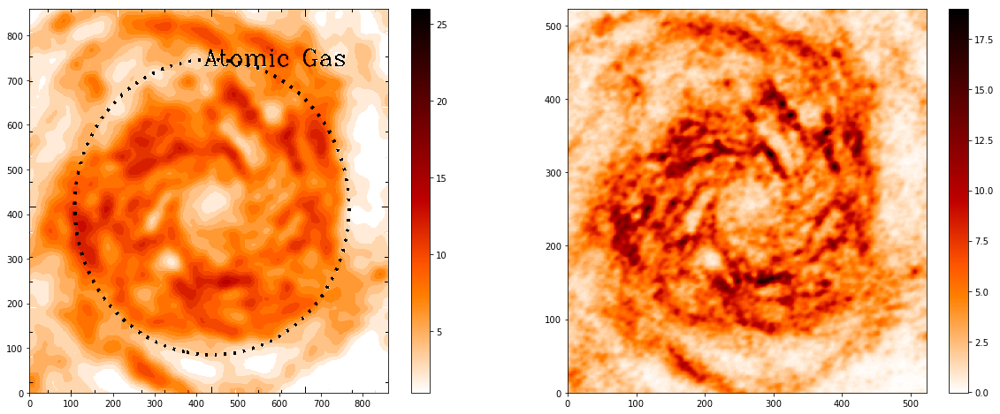

In [185]:
# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[20, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_heat_r)
# quadmesh.set_clim(vmin=10.0, vmax=26.)
plt.colorbar()
# quadmesh.cmap.set_under('white')
# quadmesh.cmap.set_over('white')

plt.subplot(1, 2, 2)
XX,YY = np.meshgrid(np.arange(0.,len(data)-500,1), np.arange(0.,len(data[0])-500,1))
quadmesh = plt.pcolormesh(XX, YY, Sigma_HI[250:-250, 250:-250], cmap=cm.gist_heat_r)
plt.colorbar();

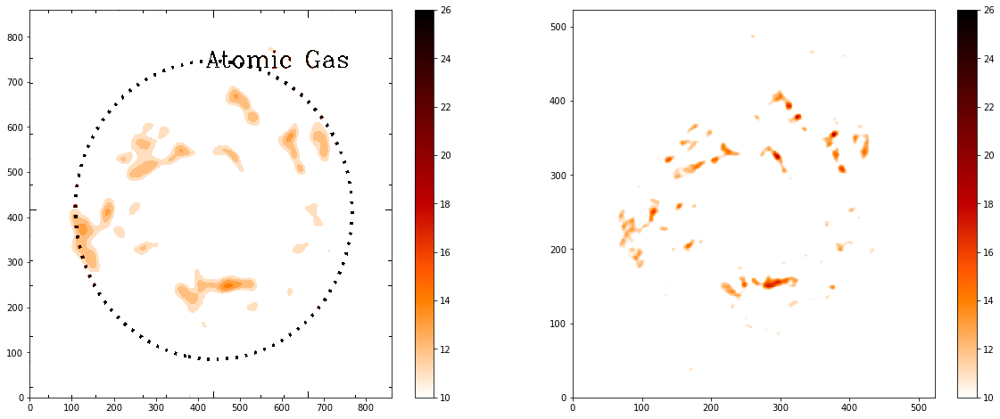

In [186]:
# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[20, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=26.)
plt.colorbar()
# quadmesh.cmap.set_under('white')
# quadmesh.cmap.set_over('white')

plt.subplot(1, 2, 2)
XX,YY = np.meshgrid(np.arange(0.,len(data)-500,1), np.arange(0.,len(data[0])-500,1))
quadmesh = plt.pcolormesh(XX, YY, Sigma_HI[250:-250, 250:-250], cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=26.)
plt.colorbar();

# Кривая вращения

In [128]:
data = np.squeeze(data)
for i in range(1024):
    for j in range(1024):
        if np.isnan(data[i][j]):
            data[i][j] = 0.

In [130]:
veloc_norm = lambda l: (l/1000. - 659.1)/sin_i

Z = veloc_norm(Z)

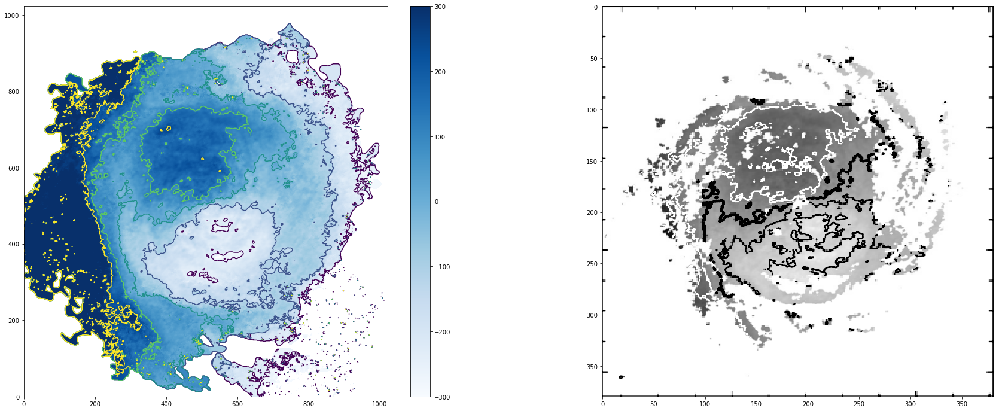

In [131]:

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.Blues)
quadmesh.set_clim(vmin=-300., vmax=300.)

# CS = plt.contour(X, Y, Z, levels=[-25., -12.5, 0., 12.5, 25.])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
quadmesh.cmap.set_under('white')

CS = plt.contour(X, Y, Z, levels=[-250., -125, 0., 125, 250.])

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('Leroy_HI_vel.png'))

In [132]:
v_HI = Z

In [13]:
np.save('v_HI.npy', v_HI)

TODO: надо ли теперь взять абсолютные значения?

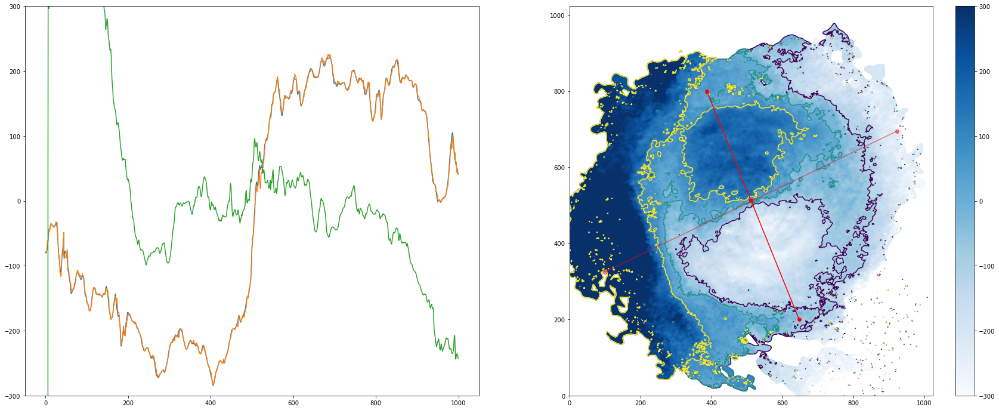

In [133]:
# https://stackoverflow.com/questions/7878398/how-to-extract-an-arbitrary-line-of-values-from-a-numpy-array
import scipy.ndimage

#-- Extract the line...
# Make a line with "num" points...
x0, y0 = 647, 200 # These are in _pixel_ coordinates!!
x1, y1 = 387, 800
num = 1000
x, y = np.linspace(x0, x1, num), np.linspace(y0, y1, num)

# Extract the values along the line, using cubic interpolation
zi = scipy.ndimage.map_coordinates(v_HI, np.vstack((y,x)))
zi_cub = v_HI[y.astype(np.int), x.astype(np.int)]


x0_, y0_ = 100, 325 # These are in _pixel_ coordinates!!
x1_, y1_ = 923, 695
num = 1000
x_, y_ = np.linspace(x0_, x1_, num), np.linspace(y0_, y1_, num)
zi_ = scipy.ndimage.map_coordinates(v_HI, np.vstack((y_,x_)))

#-- Plot...
fig, axes = plt.subplots(ncols=2, figsize = [30, 12])

axes[0].plot(zi)
axes[0].plot(zi_cub)
axes[0].plot(zi_)
axes[0].set_ylim(-300., 300.)
# axes[0].imshow(v_HI)
# axes[1].axis('image')

quadmesh = plt.pcolormesh(X, Y, v_HI, cmap=cm.Blues)
quadmesh.set_clim(vmin=-300., vmax=300.)
plt.colorbar()
# axes[1].imshow(v_HI[::-1, ])
CS = plt.contour(X, Y, v_HI, levels=[-100., 0., 100.])
axes[1].plot([x0, x1], [y0, y1], 'ro-')
axes[1].plot([x0_, x1_], [y0_, y1_], 'ro-', alpha=0.5)
axes[1].scatter([512.,], [512.,], [30.,], marker='s', color='r')
plt.show()

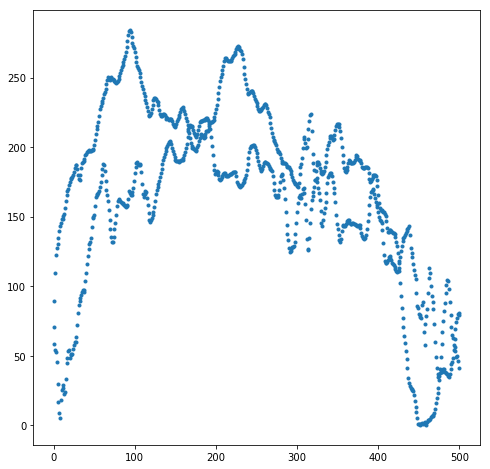

In [134]:
# CAUTION: расстояния не соответствуют настоящим вдоль среза
fig = plt.figure(figsize=[8, 8])
plt.plot(np.abs(np.arange(1000)-500.), np.abs(zi), '.');

In [135]:
r_g, vel_g = zip(*sorted(zip(np.abs(np.arange(1000)-500.), np.abs(zi))))

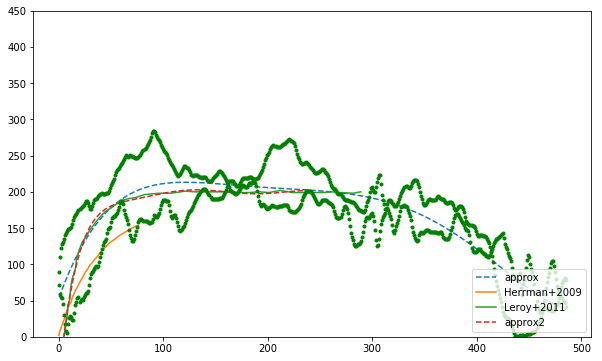

In [32]:
import scipy.interpolate as inter
fig = plt.figure(figsize=[10, 6])
gas_approx = poly1d(polyfit(r_g, vel_g, deg=5))
test_points = np.linspace(min(r_g), max(r_g), 100)
plt.plot(test_points, gas_approx(test_points), '--', label='approx')

plt.plot(herrman2009_vc[0::2], herrman2009_vc[1::2], '-', label='Herrman+2009')
plt.plot(leroy2011_vc[0::2], leroy2011_vc[1::2], '-', label='Leroy+2011')

gas_approx2 = poly1d(polyfit(leroy2011_vc[0::2], leroy2011_vc[1::2], deg=7))
plt.plot(test_points[:-50], gas_approx2(test_points[:-50]), '--', label='approx2')

plt.plot(r_g, vel_g, 'g.')
plt.ylim(0, 450)
plt.legend(loc='lower right');

# Эпициклическая частота

$$\kappa=\sqrt{2}\frac{\vartheta_c}{R}\sqrt{1+\frac{R}{\vartheta_c}\frac{d\vartheta_c}{dR}}$$

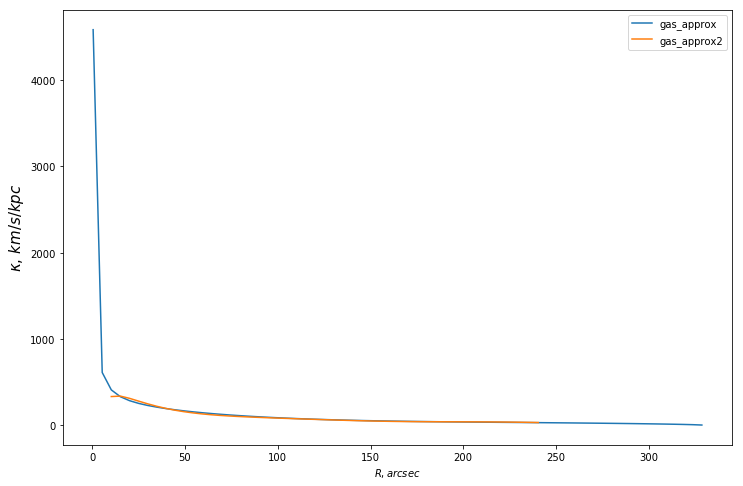

In [36]:
def epicyclicFreq_real(poly_gas, R, resolution):
    '''Честное вычисление эпициклической частоты на расстоянии R для сплайна или полинома'''
    try:
        return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.deriv()(R) / poly_gas(R)) / (R * resolution )
    except:
        return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.derivative()(R) / poly_gas(R)) / (R * resolution )

fig = plt.figure(figsize=[12, 8])
plt.plot(test_points, [epicyclicFreq_real(gas_approx, x, scale) for x in test_points], '-', label='gas_approx')
plt.plot(test_points[2:-50], [epicyclicFreq_real(gas_approx2, x, scale) for x in test_points[2:-50]], '-', label='gas_approx2')
# plt.plot(r_g_dens[1:], ef, '--')
plt.xlabel('$R, arcsec$')
plt.ylabel('$\kappa,\, km/s/kpc$', fontsize=15)
plt.legend()

# SFR

In [6]:
SFR_raw = ImagePIL.open('Leroy_SFR_scaled.png')

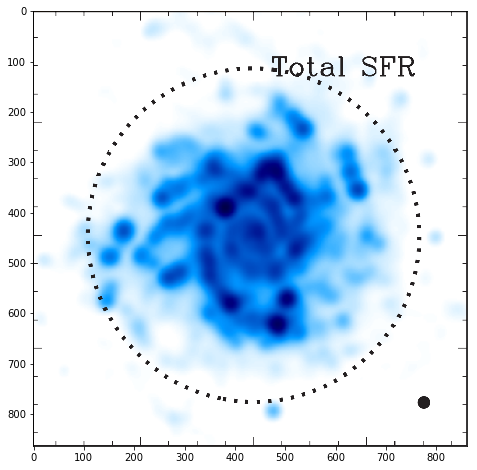

In [7]:
plt.figure(figsize=[8, 8])
plt.imshow(SFR_raw)

In [8]:
fdata = list(SFR_raw.getdata())

In [9]:
SFR_raw.height, SFR_raw.width

(864, 862)

In [11]:
disp_colorbar = ImagePIL.open('Leroy_SFR_colorbar.png')

In [12]:
disp_colorbar.width, disp_colorbar.height

(298, 863)

In [13]:
disp_colorbar = np.array(list(disp_colorbar.getdata())).reshape(863, 298, 4)

In [15]:
disp_colorbar = disp_colorbar[:, 10:11, :]

In [16]:
disp_colorbar = disp_colorbar.reshape(863, 4)

In [159]:
# 86 10-4 -> 10-3
# 365 10-3 -> 10-2

33.888888888888886

In [29]:
(0.01 - 0.001)/365

2.4657534246575345e-05

In [28]:
86/(0.001-0.0001)

95555.55555555556

In [25]:
0.0001 + 0.000010*86

0.0009600000000000001

In [19]:
364./86

4.232558139534884

In [30]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    argmin = np.argmin(np.linalg.norm(disp_colorbar - color, axis=1))
    return np.round(0.0001 + (863-argmin)*0.000022)

In [161]:
color_to_level((239, 85, 0, 255))

10.0

In [162]:
color_to_level((255, 255, 255, 255))

1.0

In [163]:
color_to_level((1, 0, 0, 255))

26.0

In [33]:
X,Y = np.meshgrid(np.arange(0.,864,1), np.arange(0.,862,1))
Z = np.array(fdata).reshape(862, 864, 4)

Z = np.apply_along_axis(color_to_level, 2, Z)
Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

In [40]:
halpha_raw = ImagePIL.open('JCMT_H_alpha.png').convert('LA')

In [41]:
halpha_raw.width, halpha_raw.height

(838, 839)

In [42]:
fdata = list(halpha_raw.getdata())

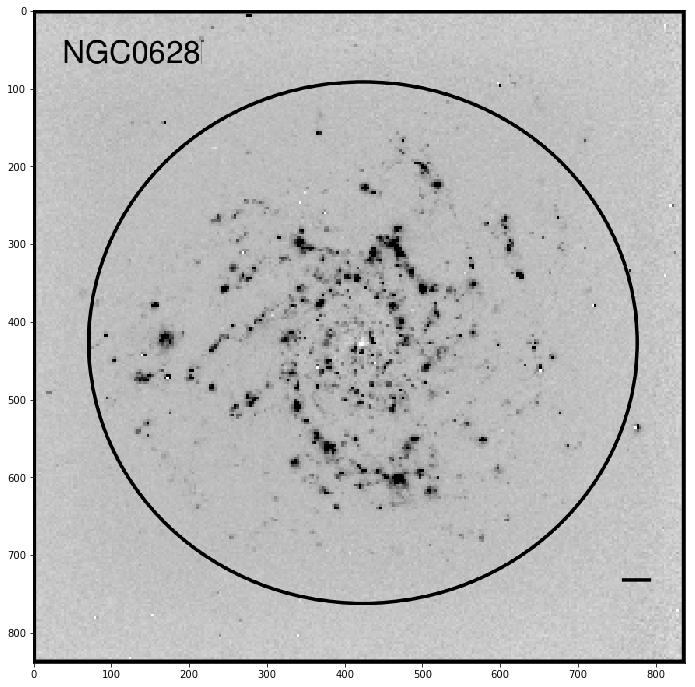

In [43]:
fig = plt.figure(figsize=[12,12])
plt.imshow(halpha_raw)

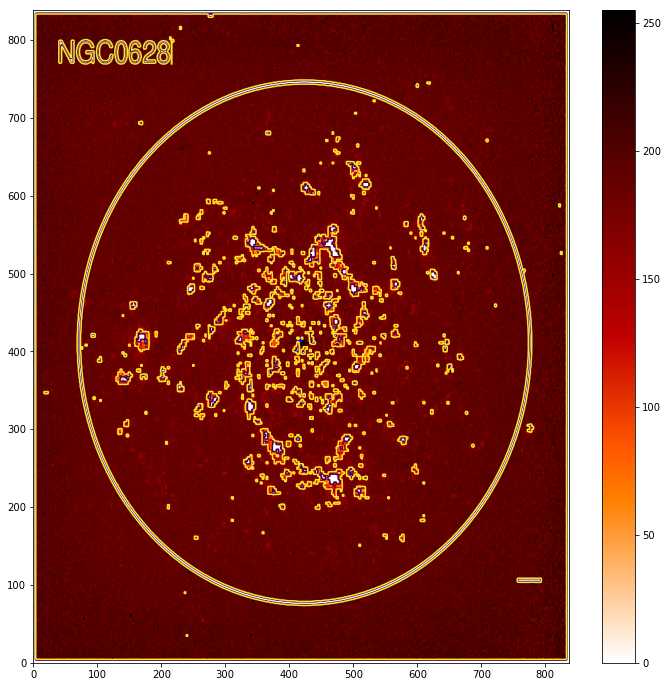

In [44]:
X,Y = np.meshgrid(np.arange(0.,838, 1), np.arange(0.,839, 1))
Z = np.array(fdata).reshape(839, 838, 2)[::-1, :, 0]

plt.figure(figsize=[12, 12])
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_heat_r)
# quadmesh.set_clim(vmin=0, vmax=70.)
plt.colorbar()
CS = plt.contour(X, Y, Z, levels=[40, 150.])
plt.scatter([416], [416], [10], marker='s', color='b')

In [45]:
# 37 px = 30 arcsec

838. * 30./37.

1524.39/1024, 1521.19/1024

(1.488662109375, 1.485537109375)

In [46]:
679./(1524.39/1024), 456/2., 512.-228.

(456.1142489782798, 228.0, 284.0)

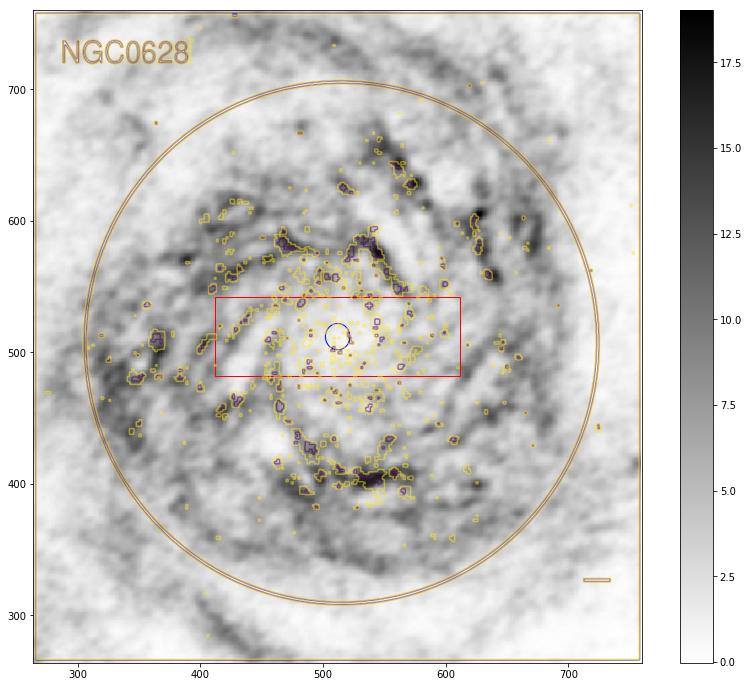

In [49]:
import matplotlib.patches as patches
X,Y = np.meshgrid(np.arange(0.,len(Sigma_HI),1), np.arange(0.,len(Sigma_HI[0]),1))

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X[264:760, 264:760], Y[264:760, 264:760], Sigma_HI[264:760, 264:760], cmap=cm.gist_yarg)
# quadmesh.set_clim(vmin=10., vmax=17.5)
plt.colorbar()

X,Y = np.meshgrid(np.linspace(264.,760, 838), np.linspace(264.,760,839))
CS = plt.contour(X, Y, Z, levels=[40., 150.], aspect='auto', alpha=0.5)
# plt.clabel(CS, inline=1, fontsize=10)

#VENGA field
rect = patches.Rectangle((412,482),200,60,linewidth=1,edgecolor='r',facecolor='none')
plt.gca().add_patch(rect)

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)

# quadmesh.cmap.set_under('white')

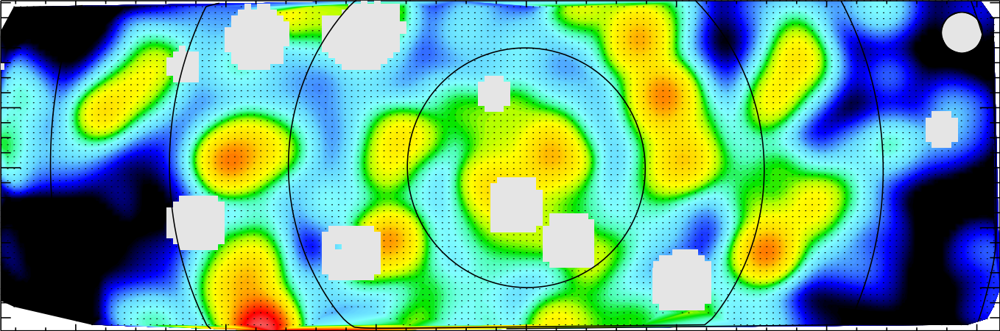

In [42]:
Image('VENGA_Halpha_SFR.png')

In [43]:
Halpha_raw = ImagePIL.open('VENGA_Halpha_SFR.png')

In [44]:
Halpha_raw.height, Halpha_raw.width

(450, 1358)

In [46]:
fdata = list(Halpha_raw.getdata())

In [48]:
disp_colorbar = ImagePIL.open('VENGA_Halpha_SFR_colorbar.png')

In [49]:
disp_colorbar.width, disp_colorbar.height

(168, 581)

In [50]:
disp_colorbar = np.array(list(disp_colorbar.getdata())).reshape(disp_colorbar.height, disp_colorbar.width, 4)

In [52]:
disp_colorbar = disp_colorbar[:, 110:111, :]

In [53]:
disp_colorbar = disp_colorbar.reshape(581, 4)

In [54]:
# 578 px = 2.5
578./2.5, 97./0.42

(231.2, 230.95238095238096)

In [55]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    argmin = np.argmin(np.linalg.norm(disp_colorbar - color, axis=1))
    return (-3.5 + (581.-argmin)/231.)

In [56]:
print color_to_level((0, 0, 252, 255))
print color_to_level((255, 216, 0, 255))
# print color_to_level((12, 12, 14, 255))

-3.07575757576
-1.82034632035


In [57]:
X,Y = np.meshgrid(np.arange(0.,1358,1), np.arange(0.,450,1))
Z = np.array(fdata).reshape(450, 1358, 4)

Z = np.apply_along_axis(color_to_level, 2, Z)
Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

In [59]:
log_Halpha_SFR = Z

In [60]:
np.save('log_Halpha_SFR.npy', log_Halpha_SFR)

In [153]:
log_Halpha_SFR.shape

(450L, 1358L)

In [154]:
xgrid = np.arange(0.,len(log_Halpha_SFR),1)
ygrid = np.arange(0.,len(log_Halpha_SFR[0]),1)
f_2d_grid = log_Halpha_SFR[::-1, :]

In [156]:
yinterp = np.linspace(0, 1358., 1553)
xinterp = np.linspace(0., 450., 513)
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

0.0 450.0 0.0 1358.0


In [157]:
points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
points = np.vstack((points_x.flatten(),
                    points_y.flatten())).T
values = f_2d_grid.flatten()
f_2d_interp = LinearNDInterpolator(points, values)

In [159]:
tmp.shape

(513L, 1553L)

In [162]:
log_Halpha_SFR_ = tmp[::-1, :]

In [163]:
np.save('log_Halpha_SFR_.npy', log_Halpha_SFR_)

# Плотность $\Sigma_{CO}$

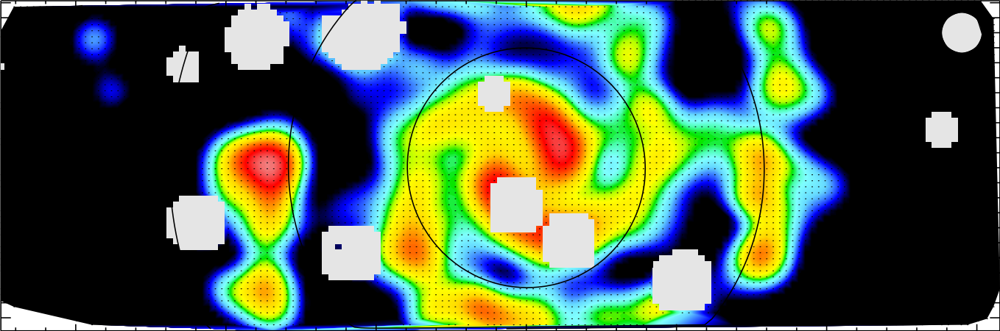

In [61]:
Image('VENGA_BIMA_CO.png')

In [62]:
CO_raw = ImagePIL.open('VENGA_BIMA_CO.png')

In [63]:
CO_raw.height, CO_raw.width

(450, 1358)

In [65]:
fdata = list(CO_raw.getdata())

In [67]:
disp_colorbar = ImagePIL.open('VENGA_BIMA_CO_colorbar.png')

In [68]:
disp_colorbar.width, disp_colorbar.height

(161, 581)

In [69]:
disp_colorbar = np.array(list(disp_colorbar.getdata())).reshape(disp_colorbar.height, disp_colorbar.width, 4)

In [71]:
disp_colorbar = disp_colorbar[:, 110:111, :]

In [72]:
disp_colorbar = disp_colorbar.reshape(581, 4)

In [73]:
# 388 px = 0.8
388./0.8

485.0

In [74]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    argmin = np.argmin(np.linalg.norm(disp_colorbar - color, axis=1))
    return (0. + (581.-argmin)/485.)

In [75]:
print color_to_level((3, 230, 80, 255))
# print color_to_level((0, 1, 252, 255))
# print color_to_level((12, 12, 14, 255))

0.585567010309


In [76]:
X,Y = np.meshgrid(np.arange(0.,1358,1), np.arange(0.,450,1))
Z = np.array(fdata).reshape(450, 1358, 4)

Z = np.apply_along_axis(color_to_level, 2, Z)
Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

In [78]:
Sigma_BIMA_CO = Z*3.2

In [79]:
np.save('Sigma_BIMA_CO.npy', Sigma_BIMA_CO)

In [140]:
Sigma_BIMA_CO.shape

(450L, 1358L)

In [141]:
xgrid = np.arange(0.,len(Sigma_BIMA_CO),1)
ygrid = np.arange(0.,len(Sigma_BIMA_CO[0]),1)
f_2d_grid = Sigma_BIMA_CO[::-1, :]

In [143]:
yinterp = np.linspace(0, 1358., 1553)
xinterp = np.linspace(0., 450., 513)
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

0.0 450.0 0.0 1358.0


In [144]:
points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
points = np.vstack((points_x.flatten(),
                    points_y.flatten())).T
values = f_2d_grid.flatten()
f_2d_interp = LinearNDInterpolator(points, values)

In [146]:
tmp.shape

(513L, 1553L)

In [150]:
Sigma_BIMA_CO_ = tmp[::-1, :]

In [151]:
np.save('Sigma_BIMA_CO_.npy', Sigma_BIMA_CO_)

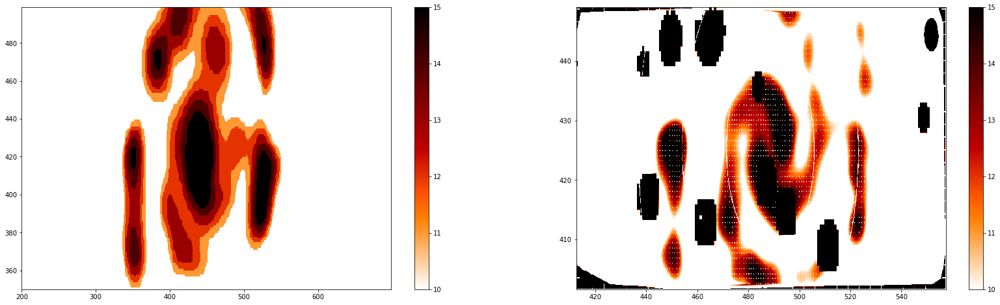

In [47]:
# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[28, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X[350:500, 200:700], Y[350:500, 200:700], Z[350:500, 200:700], cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=15.)
plt.colorbar()
# quadmesh.cmap.set_under('white')
# quadmesh.cmap.set_over('white')

plt.subplot(1, 2, 2)
XX,YY = np.meshgrid(np.linspace(489. - 175.92/2.3, 489.+157.3/2.3, 1553), np.linspace(425. - 53.82/2.3, 425. + 55.42/2.3, 513))
quadmesh = plt.pcolormesh(XX, YY, Sigma_BIMA_CO_*5.3, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=15.)
plt.colorbar();

Что-то какое-то очень сильное различие, потому что дожножать приходится.

TODO: обоснованно решить, какую их трех CARMA/HERA/BIMA карт использовать (HERA вроде лучше выглядит)

TODO: понять, почему такая разница в уровнях

TODO: учесть градиент $X_{CO}$

# $\Sigma_s$

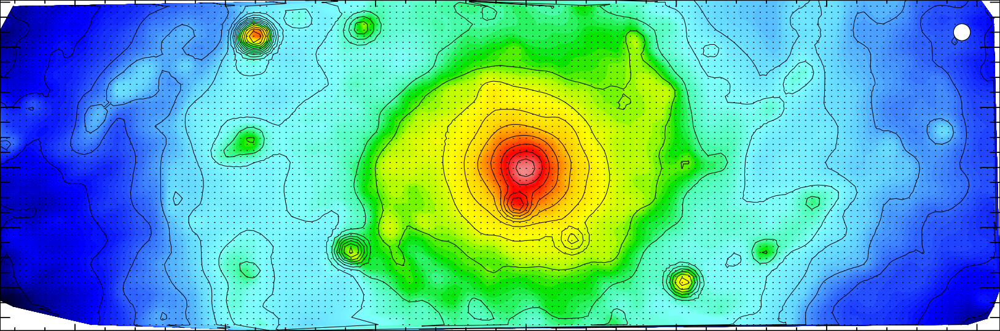

In [6]:
Image('VENGA_log_fR.png')

In [7]:
fr_raw = ImagePIL.open('VENGA_log_fR.png')

In [8]:
fr_raw.height, fr_raw.width

(539, 1627)

In [10]:
fdata = list(fr_raw.getdata())

In [12]:
disp_colorbar = ImagePIL.open('VENGA_fR_colorbar.png')

In [13]:
disp_colorbar.width, disp_colorbar.height

(258, 696)

In [14]:
disp_colorbar = np.array(list(disp_colorbar.getdata())).reshape(disp_colorbar.height, disp_colorbar.width, 4)

In [18]:
disp_colorbar = disp_colorbar[:, 210:211, :]

In [19]:
disp_colorbar = disp_colorbar.reshape(696, 4)

In [20]:
# 116 px = 0.37
116./0.37

313.51351351351354

In [22]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    argmin = np.argmin(np.linalg.norm(disp_colorbar - color, axis=1))
    return (-17.5 + (696.-argmin)/313.5135)

In [24]:
print color_to_level((255, 216, 0, 255))
print color_to_level((254, 2, 2, 255))
# print color_to_level((12, 12, 14, 255))

-16.0168102809
-15.6436206096


In [25]:
X,Y = np.meshgrid(np.arange(0.,1627,1), np.arange(0.,539,1))
Z = np.array(fdata).reshape(539, 1627, 4)

Z = np.apply_along_axis(color_to_level, 2, Z)
Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

In [29]:
log_fR = Z

In [30]:
np.save('log_fR.npy', log_fR)

In [31]:
log_fR.shape

(539L, 1627L)

In [32]:
xgrid = np.arange(0.,len(log_fR),1)
ygrid = np.arange(0.,len(log_fR[0]),1)
f_2d_grid = log_fR[::-1, :]

In [44]:
yinterp = np.linspace(0, 1627., 1553)
xinterp = np.linspace(0., 539., 513)
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

0.0 539.0 0.0 1627.0


In [45]:
points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
points = np.vstack((points_x.flatten(),
                    points_y.flatten())).T
values = f_2d_grid.flatten()
f_2d_interp = LinearNDInterpolator(points, values)

In [47]:
tmp.shape

(513L, 1553L)

In [49]:
log_fR_ = tmp[::-1, :]

In [50]:
np.save('log_fR_.npy', log_fR_)

In [7]:
log_fR_ = np.load('log_fR_.npy')

Далее, чтобы перевести все это в нужные нам величины, надо постараться.

Прежде всего, переход в STMAG mag http://web.ipac.caltech.edu/staff/fmasci/home/astro_refs/magsystems.pdf

$$m = -2.5\log_{10}F[erg\, s^{-1} \, cm^{-2} \, A] - 21.1$$

Причем надо будет проверить, что это те, которые нам нужны - может нужны болометрические? Перевод в astropy http://docs.astropy.org/en/stable/units/logarithmic_units.html 

TODO: проверить что STMAG - те, что нам нужны

Наконец, нужно перевести в поверхностные величины. Используя формулу https://en.wikipedia.org/wiki/Surface_brightness и считая, что размер $2^"\times2^" $

$$\mu = m + 2.5\log_{10}Area[arcsec^2]$$

А дальше уже по накатанной.

In [8]:
mag = -2.5*log_fR_ - 21.1

In [9]:
mu = mag + 2.5* np.log10(4.)

In [21]:
def surface_brightness(mu=None, band=None):
    '''Пересчет поверхностной яркости из mag/arcsec^2 в Lsun/pc^2 по формуле
    http://www.astro.spbu.ru/staff/resh/Books/SurfPhot/node3.html#sec1.1'''
    sun_mag = sun_abs_mags[band]
    return 4.255 * np.power(10, 8 + 0.4 * (sun_mag - mu))

surf_br = surface_brightness(mu=mu, band='r')

In [22]:
surf_br.shape

(513L, 1553L)

Теперь надо взять какое-то стандартное $M/L$, чтобы посмотреть что получается. Возьмем к примеру 1.6.

In [24]:
def surf_density(mu=None, M_to_L=None, band=None):
    '''Плотность для любого компонента галактики - пересчитываем mu в яркость и домножаем на M/L, размерность M_sun/pc^2'''
    return M_to_L*surface_brightness(mu=mu, band=band)
Sigma_s = surf_density(mu=mu, M_to_L=1.6, band='r')

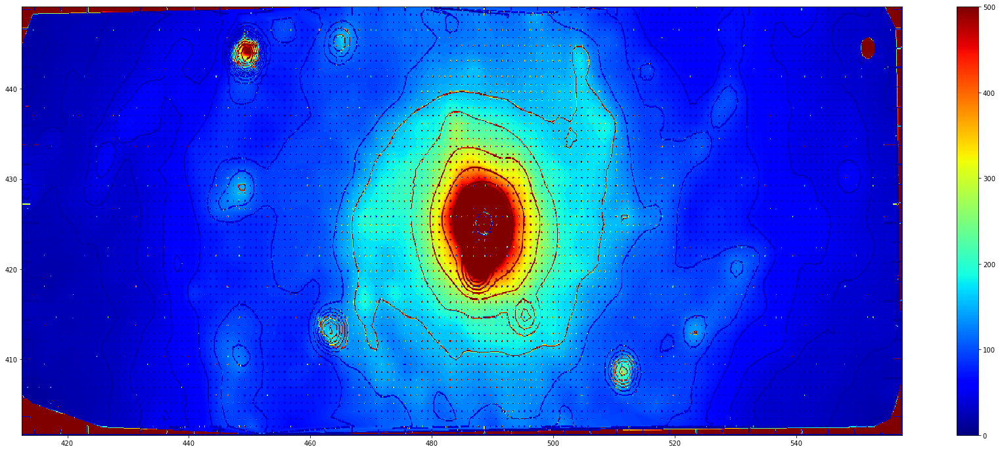

In [28]:
plt.figure(figsize=[30, 12])

X,Y = np.meshgrid(np.linspace(489. - 175.92/2.3, 489.+157.3/2.3, 1553), np.linspace(425. - 53.82/2.3, 425. + 55.42/2.3, 513))
quadmesh2 = plt.pcolormesh(X, Y, Sigma_s, cmap=cm.jet)
quadmesh2.set_clim(vmin=0., vmax=500.)
plt.colorbar()

In [29]:
np.save('Sigma_s.npy', Sigma_s)

In [142]:
Sigma_s = np.load('Sigma_s.npy')

http://irsa.ipac.caltech.edu/data/SPITZER/S4G/docs/P5_README.html

https://ui.adsabs.harvard.edu/#abs/2014ASPC..486..143Q/abstract

Попробуем применить Leroy $$\Sigma_s = 280\cos i\times I_{3.6}$$

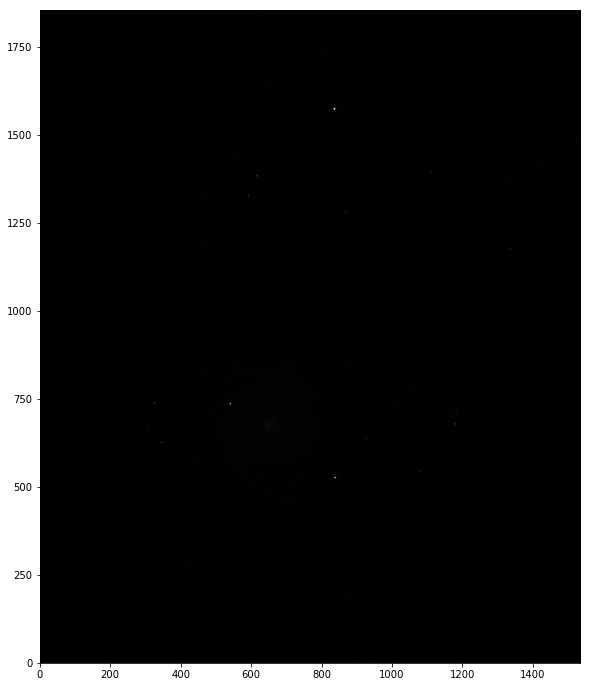

In [50]:
from astropy.io import fits

fig = plt.figure(figsize=[12,12])
data = fits.getdata('NGC0628.phot.1_nonan.fits')
plt.imshow(np.squeeze(data), origin='lower', cmap='gray')
plt.show()

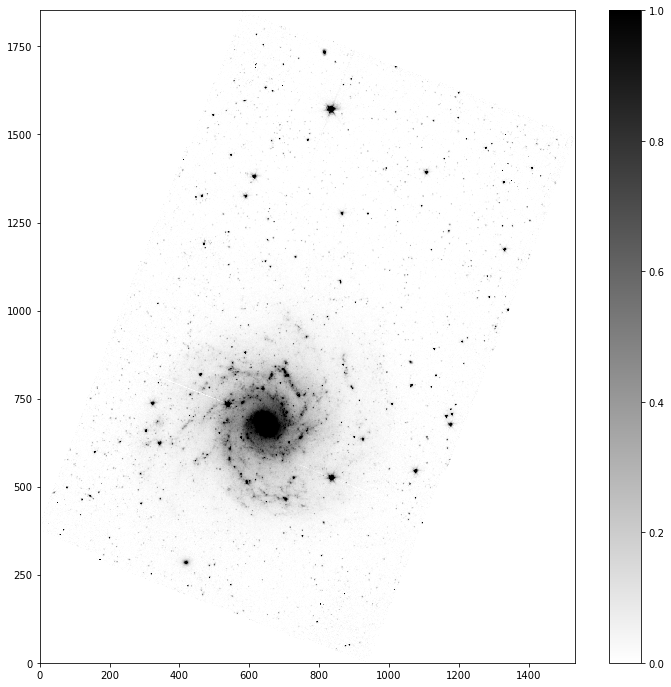

In [51]:
data = squeeze(data)
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[12, 12])
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=0., vmax=1.)

# CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
# quadmesh.cmap.set_under('white')

In [52]:
hdulist = fits.open('NGC0628.phot.1_nonan.fits')
hdulist[0].header

SIMPLE  =                    T / Written by IDL:  Thu Sep  2 18:44:02 2010      
BITPIX  =                  -32 / Bits per pixel                                 
NAXIS   =                    2 / Number of axes                                 
NAXIS1  =                 1535 / Axis length                                    
NAXIS2  =                 1853 / Axis length                                    
EXTEND  =                    T / File may contain extensions                    
ORIGIN  = 'NOAO-IRAF FITS Image Kernel July 2003' / FITS file originator        
DATE    = '2009-08-21T14:26:04' / Date FITS file was generated                  
IRAF-TLM= '2010-04-09T13:58:08' / Time of last modification                     
OBJECT  = 'NGC628  '           / Name of the object observed                    
CREATOR = 'S18.7.0 '           / SW version used to create this FITS file       
TELESCOP= 'Spitzer '           / SPITZER Space Telescope                        
INSTRUME= 'IRAC    '        

In [54]:
Z.shape

(1853L, 1535L)

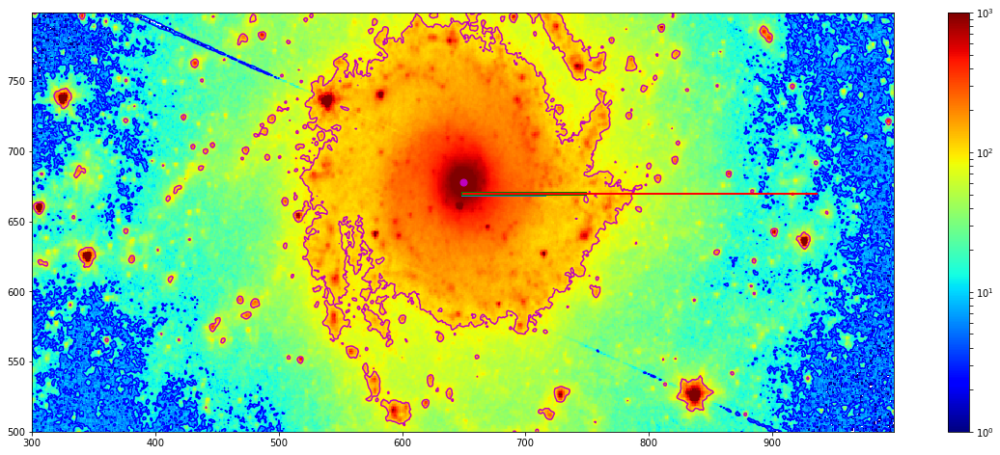

In [60]:
# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[20, 8])
quadmesh = plt.pcolormesh(X[500:800, 300:1000], Y[500:800, 300:1000], Z[500:800, 300:1000]*280*cos_i, cmap=cm.jet, norm=matplotlib.colors.LogNorm())
quadmesh.set_clim(vmin=1., vmax=1000.)
plt.colorbar()

plt.plot([650, 715],[670,670],'-', lw=5)
plt.plot([650, round(650+65*1.5)],[670,670],'-', lw=4, color='g')
plt.plot([650, round(650+65*4.4)],[670,670],'-', lw=2, color='r')

plt.scatter([650.], [678.], [50.], marker='o', color='m')



CS = plt.contour(X[500:800, 300:1000], Y[500:800, 300:1000], Z[500:800, 300:1000]*280*cos_i, levels=[10., 100.], colors=('blue', 'm'))
# plt.clabel(CS, inline=1, fontsize=10)

# quadmesh.cmap.set_under('white')

In [61]:
Sigma_s_Leroy = Z*280*cos_i

Оооооочень похоже на его усредненные радиальные данные.

TODO: использовать вместо $r$

In [ ]:
venga (59, 413)   (458, 1112)
s4g (104, 338)    (262, 563)

In [107]:
(458.-59.)/(262.-104.), (1112.-413.)/(563.-338.), 65/50.

(2.5253164556962027, 3.1066666666666665, 1.3)

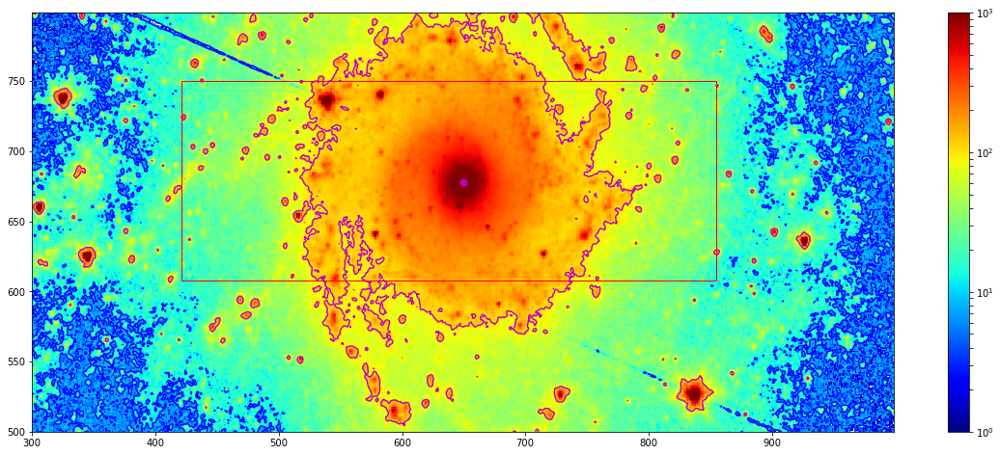

In [108]:
import matplotlib.patches as patches

plt.figure(figsize=[20, 8])
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
quadmesh = plt.pcolormesh(X[500:800, 300:1000], Y[500:800, 300:1000], Z[500:800, 300:1000]*280*cos_i, cmap=cm.jet, norm=matplotlib.colors.LogNorm())
quadmesh.set_clim(vmin=1., vmax=1000.)
plt.colorbar()

plt.scatter([650.], [678.], [50.], marker='o', color='m')

CS = plt.contour(X[500:800, 300:1000], Y[500:800, 300:1000], Z[500:800, 300:1000]*280*cos_i, levels=[10., 100.], colors=('blue', 'm'))

# scalex = 2.5/2.5253164556962027
# scaley = 2.5/3.1066666666666665

scalex = 1/1.3
scaley = 1/1.3

rect = patches.Rectangle((650. - 175.92/scalex, 678. - 53.82/scaley), 157.3/scalex+175.92/scalex, 53.82/scaley + 55.42/scaley, linewidth=1,edgecolor='r',facecolor='none')
plt.gca().add_patch(rect)

# plt.clabel(CS, inline=1, fontsize=10)

# quadmesh.cmap.set_under('white')

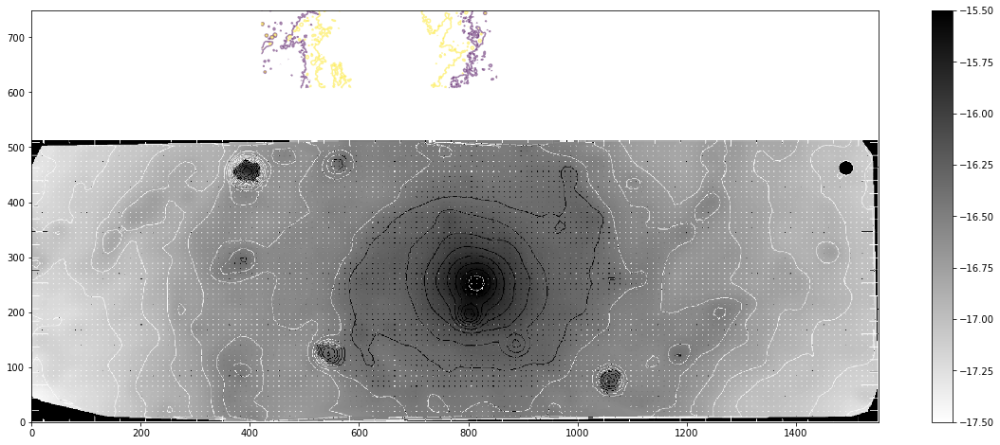

In [112]:
plt.figure(figsize=[20, 8])
log_fR_ = np.load('log_fR_.npy')

X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))
quadmesh = plt.pcolormesh(X, Y, log_fR_, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=-17.5, vmax=-15.5)
plt.colorbar()

X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
CS = plt.contour(X[608:750, 421:854], Y[608:750, 421:854], Z[608:750, 421:854]*280*cos_i, levels=[50., 100.], aspect='auto', alpha=0.5)

In [ ]:
# # PXSCAL1 =    -1.22334117768332 / [arcsec/pix] Scale for axis 1 at CRPIX1,CRPIX2 
# # PXSCAL2 =     1.22328355209902 / [arcsec/pix] Scale for axis 2 at CRPIX1,CRPIX2 

# X,Y = np.meshgrid(np.linspace(650. - 175.92/1.22334117768332, 650.+157.3/1.22334117768332, 1553), np.linspace(678. - 53.82/1.22328355209902, 678. + 55.42/1.22328355209902, 513))
# CS = plt.contour(X, Y, Z[500:800, 300:1000]*280*cos_i, levels=[40.], aspect='auto', alpha=0.5)
# plt.clabel(CS, inline=1, fontsize=10)

In [113]:
from scipy.interpolate import (
    LinearNDInterpolator, RectBivariateSpline,
    RegularGridInterpolator)
from scipy.ndimage import map_coordinates

xgrid = np.arange(0.,len(Sigma_s_Leroy),1)
ygrid = np.arange(0.,len(Sigma_s_Leroy[0]),1)
f_2d_grid = Sigma_s_Leroy[::-1, :]

yinterp = np.linspace(650. - 175.92*1.3, 650.+157.3*1.3, 1553)
xinterp = np.linspace(678. - 53.82*1.3, 678. + 55.42*1.3, 513)
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

608.034 750.046 421.304 854.49


In [ ]:
points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
points = np.vstack((points_x.flatten(),
                    points_y.flatten())).T
values = f_2d_grid.flatten()
f_2d_interp = LinearNDInterpolator(points, values)

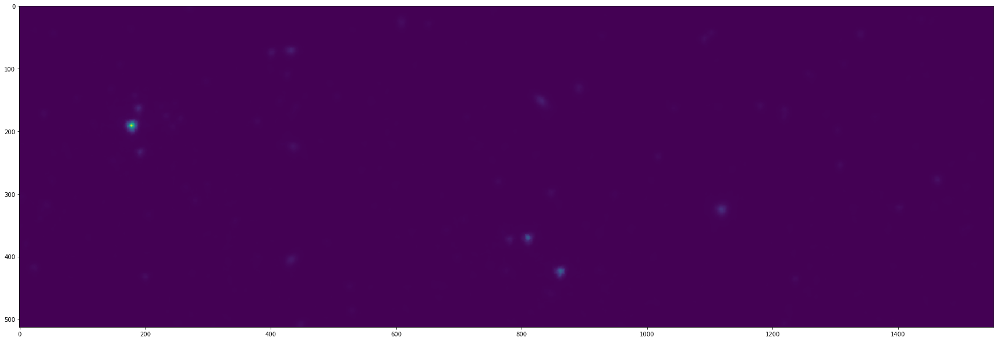

In [115]:
plt.figure(figsize=[30, 12])
tmp = f_2d_interp(xinterp.reshape(-1,1), yinterp)
plt.imshow(f_2d_interp(xinterp.reshape(-1,1), yinterp))
# plt.xlim(min(xinterp), max(xinterp))

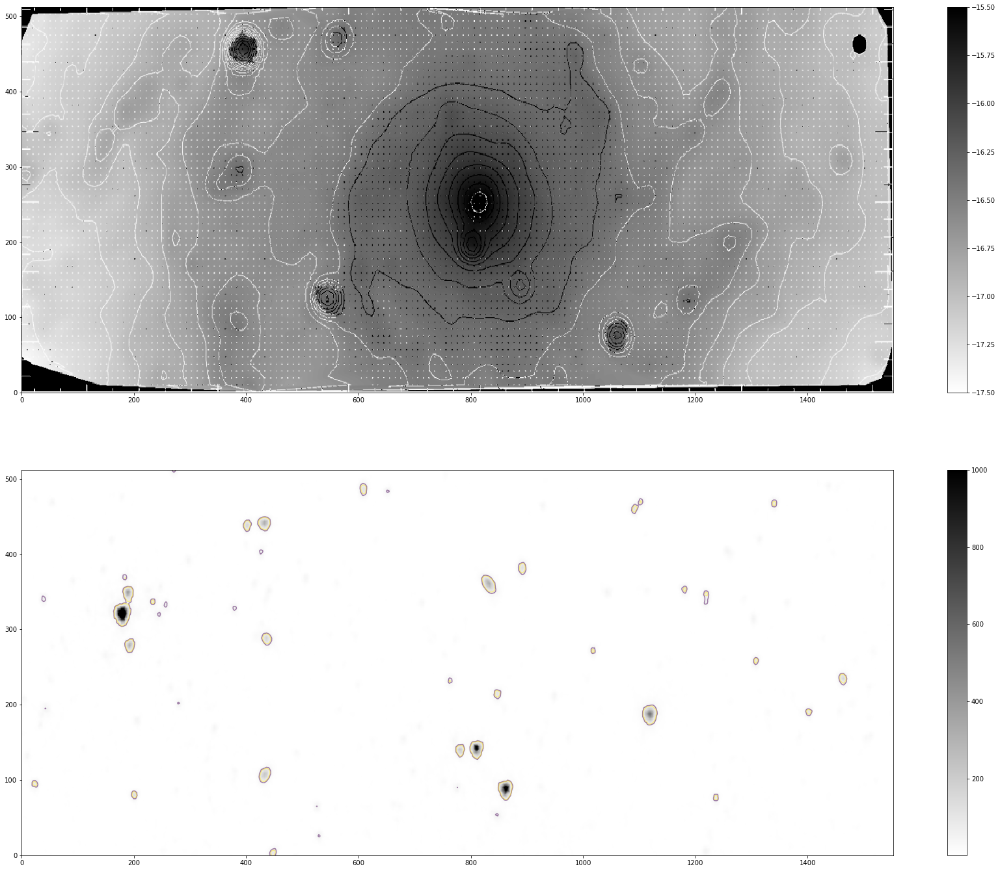

In [121]:
plt.figure(figsize=[30, 24])
plt.subplot(2, 1, 1)

log_fR_ = np.load('log_fR_.npy')

X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))
quadmesh = plt.pcolormesh(X, Y, log_fR_, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, log_fR, levels=[5., 10., 20.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-17.5, vmax=-15.5)
plt.colorbar()

# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
# CS = plt.contour(X, Y, sig_los, levels=[40.], aspect='auto', alpha=0.5)
# plt.clabel(CS, inline=1, fontsize=10)

plt.subplot(2, 1, 2)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh2 = plt.pcolormesh(X, Y, tmp[::-1, :], cmap=cm.gist_yarg)
quadmesh2.set_clim(vmin=1., vmax=1000.)
plt.colorbar()

# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
CS = plt.contour(X, Y, tmp[::-1, :], levels=[50., 70.], aspect='auto', alpha=0.5)
# plt.clabel(CS, inline=1, fontsize=10)

Из http://www.oulu.fi/astronomy/S4G_PIPELINE4/P4_paper1_010914_v2.pdf

$\mu_{3.6} = −2.5\log_{10} F + 5 \log_{10} pix + zp,$  pix = 0.75 and the zeropoint at 3.6 µm is zp = 21.097

и затем формулу (А5) из https://arxiv.org/pdf/1304.6083v1.pdf $\log_{10}\Sigma_∗(M_{\circ}{kpc}^{−2}) = 16.76 − 0.4\mu_{3.6}(AB_{mag} {arcsec}^{−2})$

http://iopscience.iop.org/article/10.1088/0004-637X/744/1/17/pdf

> Unless otherwise specified, all images are presented in units
of MJy sr−1. For conversion to mag arcsec−2 relative to Vega,
we use the zero-point fluxes 280.9, 179.7, and 64.13 Jy at 3.6,
4.5, and 8μm, respectively (Reach et al. 2005), and the 2MASS
H-band magnitude zero point provided in the image header
(Jarrett et al. 2000). Surface brightnesses in units of L pc−2
are also derived using the value of the absolute magnitude of
the Sun in the IRAC 3.6μm band, M3.6
 = 3.24 mag, calculated
by Oh et al. (2008).

По идее zero-flux - это то, на что мы делим.

In [44]:
- 2.5*np.log10(1000000*280.9)

-21.121379348003945

TODO: почему домножать, если делить??

In [55]:
def s4g_surf_density(mu=None, M_to_L=None):
    return M_to_L*np.power(10., 16.76 - 0.4*mu)/1000000.

def s4g_flux_to_mu(flux, zero):
    return -2.5*np.log10(flux) + 2.5*np.log10(1000000*zero) + 5*np.log10(0.74)

Z = np.apply_along_axis(lambda l: s4g_surf_density(s4g_flux_to_mu(l, 280.9), M_to_L=0.6), 0, s4g_stellar)
# Z = np.apply_along_axis(lambda l: s4g_flux_to_mu(l, 280.9), 0, s4g_stellar)

In [88]:
hdulist = fits.open('NGC0628.stellar.fits')
hdulist[0].header

SIMPLE  =                    T / Written by IDL:  Fri Aug 22 13:25:08 2014      
BITPIX  =                  -32 / Bits per pixel                                 
NAXIS   =                    2 / Number of axes                                 
NAXIS1  =                  853 /Number of positions along axis 1                
NAXIS2  =                 1029 /Number of positions along axis 2                
EXTEND  =                    T / File may contain extensions                    
COMMENT 3.6um s1 map, old stellar flux (S4G P5, ICA). M.Querejeta, Feb 2014     
ORIGIN  = 'NOAO-IRAF FITS Image Kernel July 2003' / FITS file originator        
DATE    = '2009-08-21T14:26:04' / Date FITS file was generated                  
IRAF-TLM= '2010-04-09T13:58:08' / Time of last modification                     
OBJECT  = 'NGC628  '           / Name of the object observed                    
CREATOR = 'S18.7.0 '           / SW version used to create this FITS file       
TELESCOP= 'Spitzer '        

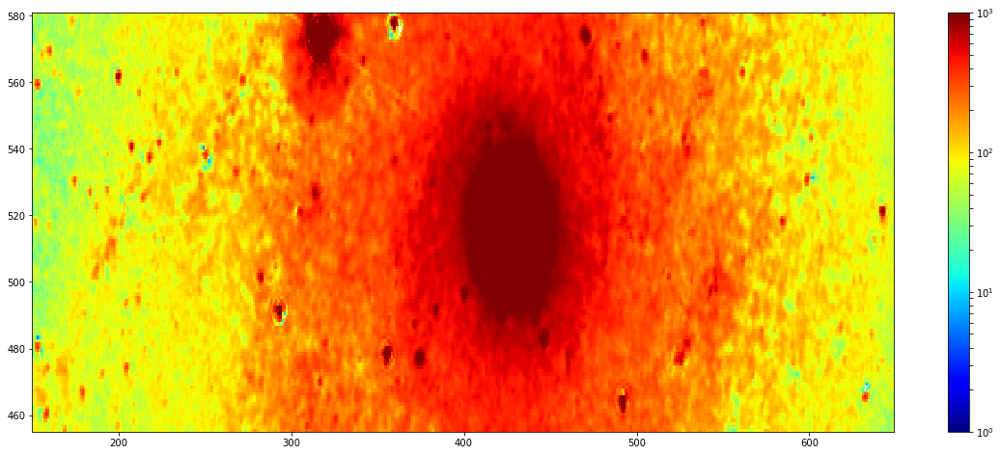

In [87]:
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
Z1 = s4g_stellar*1000

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[20, 8])
quadmesh = plt.pcolormesh(X[455:582, 150:650], Y[455:582, 150:650], Z1[455:582, 150:650], cmap=cm.jet, norm=matplotlib.colors.LogNorm())
quadmesh.set_clim(vmin=1., vmax=1000.)

# CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
# quadmesh.cmap.set_under('white')

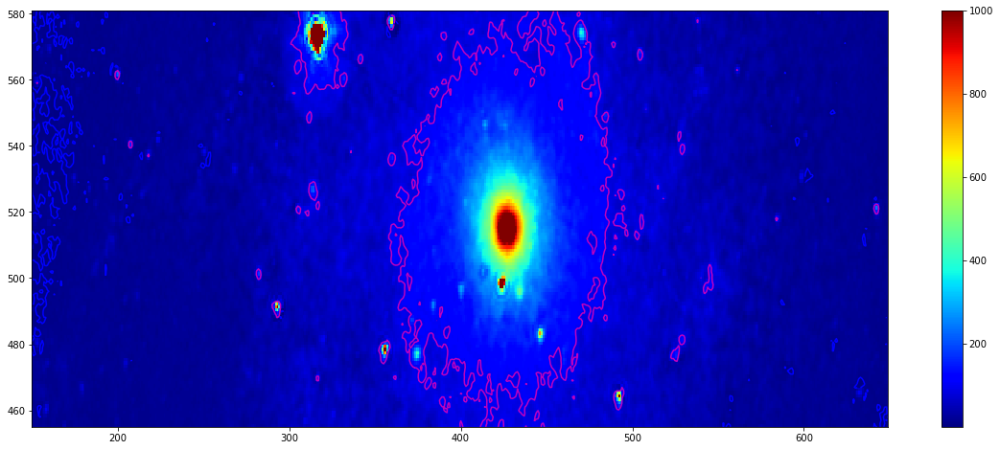

In [56]:
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[20, 8])
quadmesh = plt.pcolormesh(X[455:582, 150:650], Y[455:582, 150:650], Z[455:582, 150:650], cmap=cm.jet)
# quadmesh.set_clim(vmin=14., vmax=28.)
quadmesh.set_clim(vmin=1., vmax=1000.)
plt.colorbar()

CS = plt.contour(X[455:582, 150:650], Y[455:582, 150:650], Z[455:582, 150:650], levels=[10., 100.], colors=('blue', 'm'))
# CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

# quadmesh.cmap.set_under('white')

# Дисперсии

## HI

In [67]:
sigma_raw = ImagePIL.open('THINGS_HI_disp.png').convert('LA')

In [69]:
sigma_raw.height, sigma_raw.width

(760, 761)

In [70]:
fdata = list(sigma_raw.getdata())

In [71]:
X,Y = np.meshgrid(np.arange(0.,761,1), np.arange(0.,760,1))
Z = np.array(fdata).reshape(760, 761, 2)[::-1, :, 0]

In [85]:
# import itertools

# for i, row in enumerate(Z):
#     for j, col in enumerate(Z[i]):
#         if Z[i][j] == 0:
#             neigb = []
#             for i1, j1 in list(itertools.product([i, i+1, i-1], [j, j+1, j-1])):
#                 if not (i1 == i and j1 ==j):
#                     try:
#                         if Z[i1][j1] != 0:
#                             neigb.append(Z[i1][j1])
#                     except IndexError:
#                         pass
#             if len(neigb):
#                 Z[i][j] = sum(neigb)/len(neigb)

In [ ]:
# 5, 10, 20

In [ ]:
# 225 - 5
# 190 - 10
# 130 - 20

In [147]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    return (255.-color)/6.

In [148]:
print color_to_level(225.)
print color_to_level(190.)
print color_to_level(130.)

5.0
10.8333333333
20.8333333333


In [149]:
X,Y = np.meshgrid(np.arange(0.,761,1), np.arange(0.,760,1))
Z = np.array(fdata).reshape(760, 761, 2)[::-1, :, 0]
Z = np.apply_along_axis(color_to_level, 0, Z)

In [81]:
data = np.squeeze(data)

In [82]:
for i in range(1024):
    for j in range(1024):
        if np.isnan(data[i][j]):
            data[i][j] = 0.

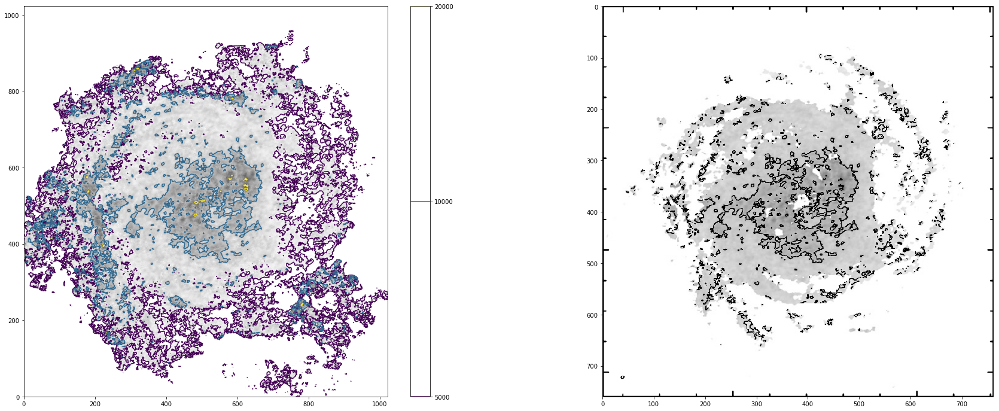

In [83]:
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=4000., vmax=30000.)

CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
quadmesh.cmap.set_under('white')

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('THINGS_HI_disp.png'))

In [84]:
c_g = Z/1000.

In [85]:
np.save('c_g.npy', c_g)

## CO

In [87]:
codisp_raw = ImagePIL.open('JCMT_CO_disp_rot_cleared.png').convert('LA')

In [88]:
codisp_raw.width, codisp_raw.height

(969, 951)

In [89]:
fdata = list(codisp_raw.getdata())

In [91]:
X,Y = np.meshgrid(np.arange(0.,codisp_raw.width, 1), np.arange(0.,codisp_raw.height, 1))
Z = np.array(fdata).reshape(codisp_raw.height, codisp_raw.width, 2)[::-1, :, 0]

In [92]:
for i in range(len(Z)):
    for j in range(len(Z[0])):
        if Z[i][j] == 255 or Z[i][j] == 205:
            Z[i][j] = 0

In [94]:
# 69 - 5
# 115 - 10
# 45 - 2.5
# 22 - 0.

In [96]:
# unique, counts = np.unique(Z, return_counts=True)
# print np.asarray((unique, counts)).T

In [97]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    return (color)/16.7

In [98]:
# X,Y = np.meshgrid(np.arange(0.,969,1), np.arange(0.,951,1))
# Z = np.array(fdata).reshape(951, 969, 2)

Z = np.apply_along_axis(color_to_level, 1, Z)
# Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

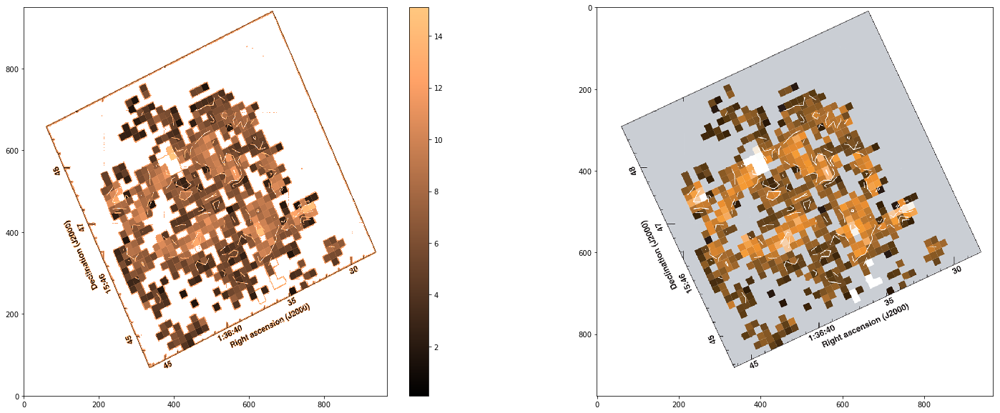

In [99]:
plt.figure(figsize=[25, 10])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.copper)
quadmesh.set_clim(vmin=0.1, vmax=15.1)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
# CS = plt.contour(X, Y, Z, levels=[2.5])

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('JCMT_CO_disp_rot_cleared.png'), aspect=1.);

In [100]:
CO_disp = Z

In [102]:
np.save('CO_disp.npy', CO_disp)

In [172]:
# hor 497 px = 15 sec = 216.5 arcsec
# ver 414px = 3 min = 180 arcsec
497./216.5, 414./180

(2.295612009237875, 2.3)

In [156]:
from astropy.coordinates import SkyCoord
from astropy import units as u
c = SkyCoord(ra='01h36m45s', dec='+15d44.5m')
c2 = SkyCoord(ra='01h36m30s', dec='+15d44.5m')
print c.separation(c2).arcsec

c = SkyCoord(ra='01h36m45s', dec='+15d45.0m')
c2 = SkyCoord(ra='01h36m45s', dec='+15d48.0m')
c.separation(c2).arcsec

216.561307989


180.0000000000012

In [104]:
X,Y = np.meshgrid(np.linspace(489. - 175.92/2.3, 489.+157.3/2.3, 1553), np.linspace(425. - 53.82/2.3, 425. + 55.42/2.3, 513))

In [123]:
xgrid = np.arange(0.,len(CO_disp),1)
ygrid = np.arange(0.,len(CO_disp[0]),1)
f_2d_grid = CO_disp[::-1, :]

In [125]:
CO_disp.shape

(951L, 969L)

In [126]:
yinterp = np.linspace(969-489. - 175.92/2.3, 969-489. + 157.3/2.3, 1553)
xinterp = np.linspace(951-425. - 53.82/2.3, 951-425. + 55.42/2.3, 513)
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

502.6 550.095652174 403.513043478 548.391304348


In [127]:
points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
points = np.vstack((points_x.flatten(),
                    points_y.flatten())).T
values = f_2d_grid.flatten()
f_2d_interp = LinearNDInterpolator(points, values)

In [130]:
tmp.shape

(513L, 1553L)

In [132]:
c_CO_ = tmp[::-1, :]

In [133]:
np.save('c_CO_.npy', c_CO_)

## sig_los

σ2los,φ = [σ2Rsin2φ + σ2ϕcos2φ] sin2i + σ2zcos2i, where φ is the angle between the slit and the major axis of the
projected stellar disc (the position angle)

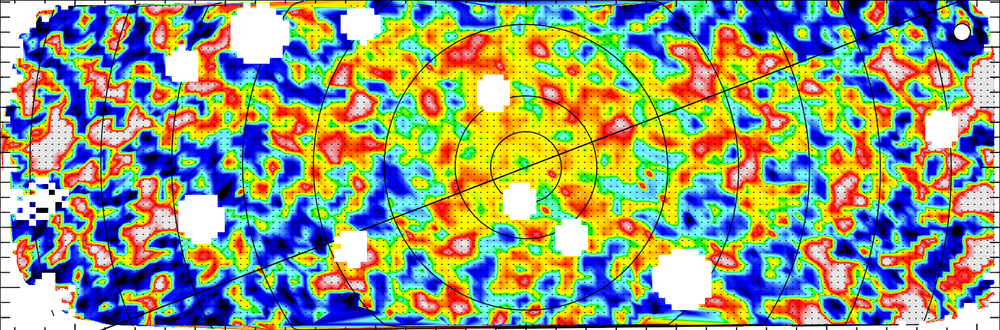

In [20]:
Image('VENGA_sig_los.png')

In [21]:
sig_raw = ImagePIL.open('VENGA_sig_los.png')

In [22]:
sig_raw.height, sig_raw.width

(513, 1553)

In [24]:
fdata = list(sig_raw.getdata())

In [26]:
disp_colorbar = ImagePIL.open('VENGA_sig_los_colorbar.png')

In [27]:
disp_colorbar.width, disp_colorbar.height

(208, 665)

In [28]:
disp_colorbar = np.array(list(disp_colorbar.getdata())).reshape(disp_colorbar.height, disp_colorbar.width, 4)

In [30]:
disp_colorbar = disp_colorbar[:, 110:111, :]

In [31]:
disp_colorbar = disp_colorbar.reshape(665, 4)

In [32]:
# 110 px = 12.33 km/s
110./12.33

8.921330089213301

In [33]:
def color_to_level(color):
    '''Вычисляем исходную величину из цвета'''
    argmin = np.argmin(np.linalg.norm(disp_colorbar - color, axis=1))
    return (6. + (665.-argmin)/8.921330089213301)

In [34]:
print color_to_level((102, 215, 255, 255))
print color_to_level((0, 1, 252, 255))
print color_to_level((12, 12, 14, 255))

31.3325454545
18.4420909091
6.33627272727


In [35]:
X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))
Z = np.array(fdata).reshape(513, 1553, 4)

Z = np.apply_along_axis(color_to_level, 2, Z)
Z = Z[::-1, :] #inverse axes
# Z[Z < 0] = 0.

In [37]:
# hor 22px 34px
# ver 18px 2px

# ver 494 px = 105 arcsec
# hor 1494px = 320

1494/320., 46./10, 494./105, 23./5

(4.66875, 4.6, 4.704761904761905, 4.6)

In [38]:
print 'hor: ', -23./4.66875-170., 34./4.66875 + 150
print 'ver: ', -18./4.7047-50., 2./4.7047 + 55.

hor:  -174.926372155 157.282463186
ver:  -53.8259612728 55.4251068081


In [39]:
sig_los = Z

In [40]:
np.save('sig_los.npy', sig_los)

In [30]:
sig_los = np.load('sig_los.npy')

In [48]:
1553./2, 513./2

(776.5, 256.5)

In [90]:
import math

def dotproduct(v1, v2):
    return sum((a*b) for a, b in zip(v1, v2))

def length(v):
    return math.sqrt(dotproduct(v, v))

def angle(v1, v2):
    return math.acos(dotproduct(v1, v2) / (length(v1) * length(v2)))

In [113]:
phi = np.zeros(sig_los.shape)

for i in range(len(sig_los[0])):
    for j in range(len(sig_los)):
        x, y  = 813.5-i, 253.5-j
#         x, y  = i-253.5, j - 813.5
#         scalar = (253.5-1553.)*x + (813.5 - 1553.*np.sin(22.5*np.pi/180.)-60.)*y
#         scalar_cos = scalar/sqrt(((1553. - 253.5)**2 + (1553*np.sin(22.5*np.pi/180.)-60. - 813.5)**2)*(x**2 + y**2))
#         phi[i][j] = np.arccos(scalar_cos)*180./np.pi
        phi[j][i] = angle(np.array([x,y]), np.array([1553., 1553*np.sin(22.5*np.pi/180.)-60.]))*180./np.pi
#         phi[i][j] = scalar

In [118]:
sig_r_max = lambda sig, phi_: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + 0.25*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.09*cos_i**2) 
sig_r_min = lambda sig, phi_: sig/np.sqrt(sin_i**2 + 0.49*cos_i**2) 

In [120]:
sig_R_max = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_max[i][j] = sig_r_max(sig_los[i][j], phi[i][j])
        
sig_R_min = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_min[i][j] = sig_r_min(sig_los[i][j], phi[i][j])

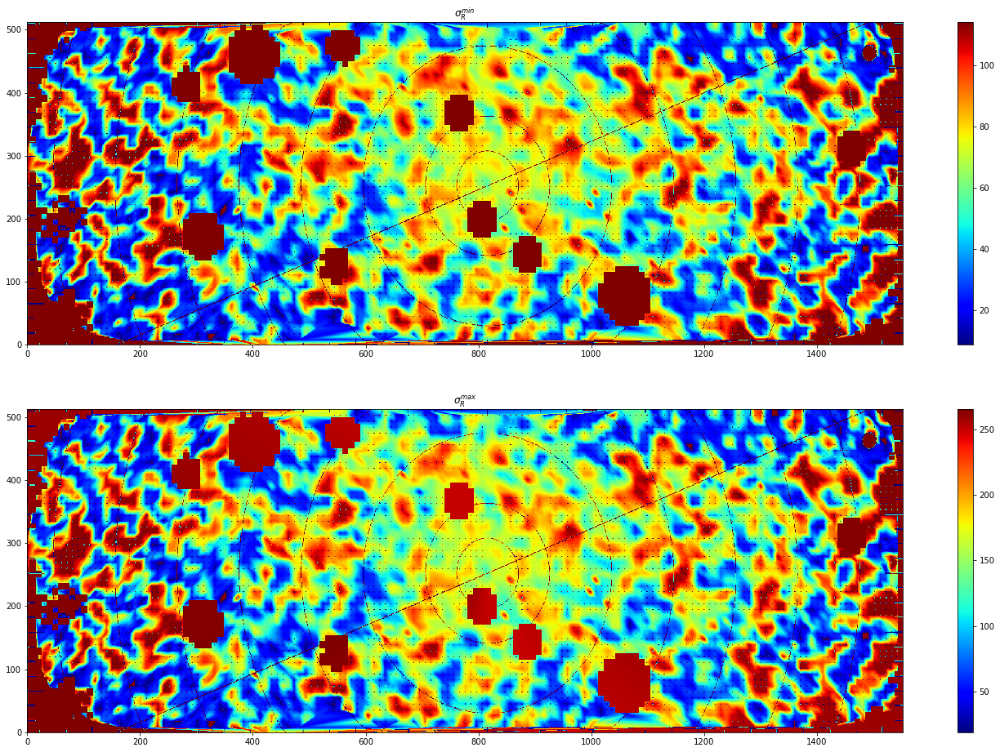

In [123]:
plt.figure(figsize=[24, 16])
plt.subplot(2,1,1)
quadmesh = plt.pcolormesh(X, Y, sig_R_min, cmap=cm.jet)
# quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
plt.title(r'$\sigma_R^{min}$')

plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, sig_R_max, cmap=cm.jet)
# quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
plt.title(r'$\sigma_R^{max}$')

In [138]:
np.save('sig_R_max.npy', sig_R_max)
np.save('sig_R_min.npy', sig_R_min)

In [11]:
%%time
import scipy.interpolate
# https://stackoverflow.com/questions/37872171/how-can-i-perform-two-dimensional-interpolation-using-scipy

X,Y = np.meshgrid(np.arange(0.,len(Sigma_HI),1), np.arange(0.,len(Sigma_HI[0]),1))
f = scipy.interpolate.interp2d(X[470:560, 380:650], Y[470:560, 380:650], Sigma_HI[470:560, 380:650])

Wall time: 5min 40s


C:\Anaconda\lib\site-packages\scipy\interpolate\_fitpack_impl.py:975: RuntimeWarning: No more knots can be added because the number of B-spline
coefficients already exceeds the number of data points m.
Probable causes: either s or m too small. (fp>s)
	kx,ky=1,1 nx,ny=250,100 m=24300 fp=0.429796 s=0.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


In [12]:
xvalues = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
yvalues = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
zvalues = f(xvalues, yvalues)

In [13]:
Sigma_HI_ = zvalues

In [18]:
np.save('Sigma_HI_.npy', Sigma_HI_)

In [14]:
dist = np.load('dist_map.npy')

In [15]:
X,Y = np.meshgrid(np.arange(0.,len(Sigma_HI),1), np.arange(0.,len(Sigma_HI[0]),1))
f = scipy.interpolate.interp2d(X[470:560, 380:650], Y[470:560, 380:650], dist[470:560, 380:650])

C:\Anaconda\lib\site-packages\scipy\interpolate\_fitpack_impl.py:975: RuntimeWarning: No more knots can be added because the number of B-spline
coefficients already exceeds the number of data points m.
Probable causes: either s or m too small. (fp>s)
	kx,ky=1,1 nx,ny=261,96 m=24300 fp=0.000003 s=0.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


In [16]:
xvalues = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
yvalues = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
zvalues = f(xvalues, yvalues)

In [17]:
dist_ = zvalues

In [19]:
np.save('dist_.npy', dist_)

In [12]:
# %%time
# import scipy.interpolate
# X,Y = np.meshgrid(np.arange(0.,len(c_g),1), np.arange(0.,len(c_g[0]),1))
# f = scipy.interpolate.interp2d(X[470:560, 380:650], Y[470:560, 380:650], c_g[470:560, 380:650], kind='cubic')

Wall time: 32min 46s


C:\Anaconda\lib\site-packages\scipy\interpolate\_fitpack_impl.py:975: RuntimeWarning: A theoretically impossible result when finding a smoothing spline
with fp = s. Probable causes: s too small or badly chosen eps.
(abs(fp-s)/s>0.001)
	kx,ky=3,3 nx,ny=96,83 m=24300 fp=4456761980445583741391644655616.000000 s=0.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


In [13]:
# xvalues = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
# yvalues = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
# zvalues = f(xvalues, yvalues)

In [14]:
# c_g_ = zvalues

In [112]:
from scipy.interpolate import (
    LinearNDInterpolator, RectBivariateSpline,
    RegularGridInterpolator)
from scipy.ndimage import map_coordinates
# https://nbviewer.jupyter.org/github/pierre-haessig/stodynprog/blob/master/stodynprog/linear_interp_benchmark.ipynb

In [113]:
# xgrid = np.arange(0.,len(c_g),1)[470:560]
# ygrid = np.arange(0.,len(c_g),1)[380:650]
# f_2d_grid = c_g[470:560, 380:650][::-1, :]

xgrid = np.arange(0.,len(c_g),1)
ygrid = np.arange(0.,len(c_g),1)
f_2d_grid = c_g[::-1, :]

In [116]:
yinterp = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
xinterp = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

476.12 548.946666667 394.72 616.866666667


In [117]:
points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
points = np.vstack((points_x.flatten(),
                    points_y.flatten())).T
values = f_2d_grid.flatten()
f_2d_interp = LinearNDInterpolator(points, values)

In [119]:
tmp.shape

(513L, 1553L)

In [121]:
c_g_ = tmp[::-1, :]

In [122]:
np.save('c_g_.npy', c_g_)

# Все в одном

In [125]:
Sigma_HI_ = np.load('Sigma_HI_.npy')
sig_los = np.load('sig_los.npy')
c_g_ = np.load('c_g_.npy')
c_CO_ = np.load('c_CO_.npy')
dist_ = np.load('dist_.npy')
Sigma_BIMA_CO_ = np.load('Sigma_BIMA_CO_.npy')
log_Halpha_SFR_ = np.load('log_Halpha_SFR_.npy')

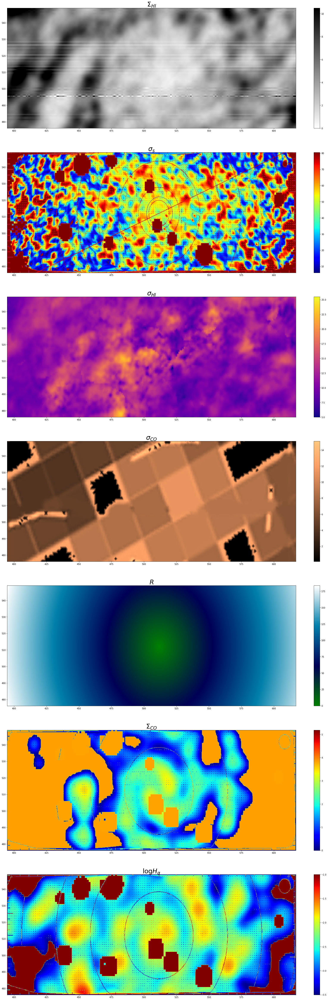

In [6]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 84])
plt.subplot(7, 1, 1)
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Sigma_HI_, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=10.5)
plt.colorbar()
plt.title(r'$\Sigma_{HI}$', fontsize=30)


plt.subplot(7, 1, 2)
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
CS = plt.contour(X, Y, sig_los, levels=[40., 70.], aspect='auto', alpha=0.5, colors='r')
plt.clabel(CS, inline=1, fontsize=10)
plt.title(r'$\sigma_{s}$', fontsize=30)
quadmesh2 = plt.pcolormesh(X, Y, sig_los, cmap=cm.jet)
# quadmesh2.set_clim(vmin=0., vmax=10.5)
plt.colorbar()

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)


plt.subplot(7, 1, 3)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, c_g_, cmap=cm.plasma)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=5., vmax=25.5)
plt.colorbar()
plt.title(r'$\sigma_{HI}$', fontsize=30)

plt.subplot(7, 1, 4)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, c_CO_, cmap=cm.copper)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=.1, vmax=15.1)
plt.colorbar()
plt.title(r'$\sigma_{CO}$', fontsize=30)

plt.subplot(7, 1, 5)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, dist_, cmap=cm.ocean)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
# quadmesh.set_clim(vmin=.1, vmax=15.1)
plt.colorbar()
plt.title(r'$R$', fontsize=30)

plt.subplot(7, 1, 6)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, Sigma_BIMA_CO_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=5.19)
plt.colorbar()
plt.title(r'$\Sigma_{CO}$', fontsize=30)

plt.subplot(7, 1, 7)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-3.5, vmax=-1.)
plt.colorbar()
plt.title(r'$\log H_{\alpha}$', fontsize=30)

# X,Y = np.meshgrid(np.arange(0.,len(c_g),1), np.arange(0.,len(c_g[0]),1))
# CS = plt.contour(X[470:560, 380:650], Y[470:560, 380:650], c_g[470:560, 380:650], levels=[5., 10., 20.], aspect='auto', alpha=0.5)

# Qg

$$Q_g = \frac{\sigma\varkappa}{\pi G \Sigma}$$

In [204]:
G = 4.32
Qgs = np.zeros(v_HI.shape)

for i, row in enumerate(v_HI):
    for j, col in enumerate(v_HI):
        c = c_g[i][j]
        Sigma = Sigma_HI[i][j]
        kappa = epi4[i][j]
        Qgs[i][j] = kappa * c / (math.pi * G * Sigma)

C азимутально-усредненной эпициклической частотой и дисперсиями газа от водорода:

In [31]:
G = 4.32
Qgs = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = Sigma_HI_[i][j] + Sigma_BIMA_CO_[i][j]
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Qgs[i][j] = kappa * c / (math.pi * G * Sigma)

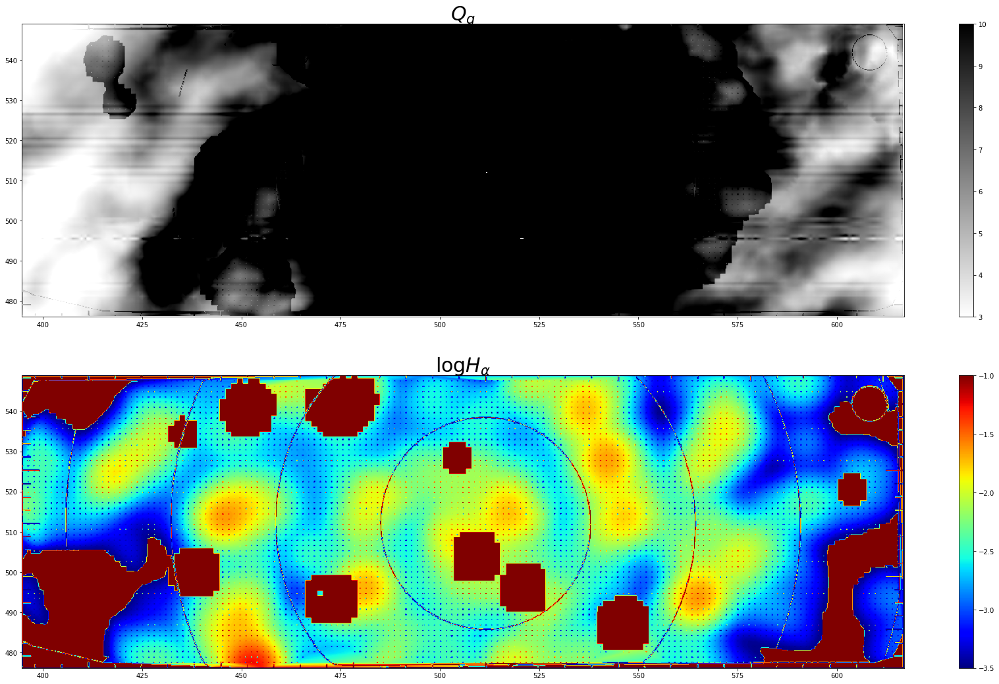

In [34]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 18])
plt.subplot(2, 1, 1)
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=3., vmax=10.)
plt.colorbar()
plt.title(r'$Q_g$', fontsize=30)


plt.subplot(2, 1, 2)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-3.5, vmax=-1.)
plt.colorbar()
plt.title(r'$\log H_{\alpha}$', fontsize=30)

# X,Y = np.meshgrid(np.arange(0.,len(c_g),1), np.arange(0.,len(c_g[0]),1))
# CS = plt.contour(X[470:560, 380:650], Y[470:560, 380:650], c_g[470:560, 380:650], levels=[5., 10., 20.], aspect='auto', alpha=0.5)

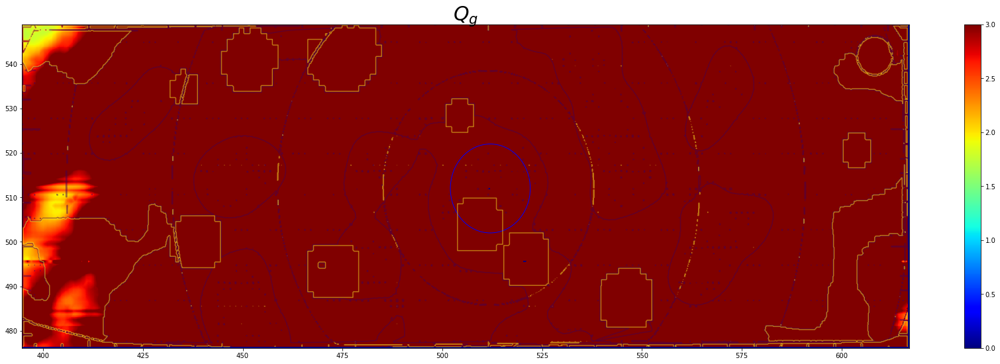

In [38]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()

plt.title(r'$Q_g$', fontsize=30)

CS = plt.contour(X, Y, log_Halpha_SFR_, levels=[-2.25, -1.], aspect='auto', alpha=0.5)

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)

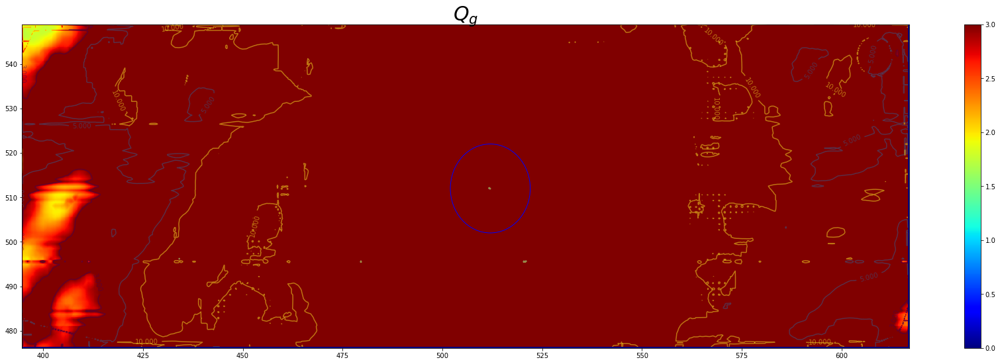

In [41]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()

CS = plt.contour(X, Y, Qgs, levels=[3., 5., 10.], aspect='auto', alpha=0.5)
plt.clabel(CS, inline=1, fontsize=10)

plt.title(r'$Q_g$', fontsize=30)

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)

In [144]:
%%time

G = 4.32
# Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = Sigma_HI_[i][j] + Sigma_BIMA_CO_[i][j]
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)
        Qs_min = kappa * s_R_min / (3.36 * G * Sigma_s_)
        try:
            qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 1000., 1.))[1]
        except ValueError:
            qeff = 0.01
        Qeff_min[i][j] = 1./qeff

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [145]:
np.save('Qeff_min.npy', Qeff_min)

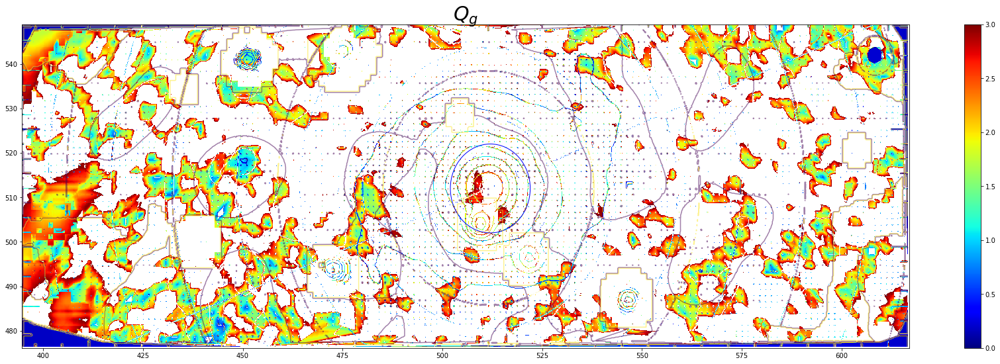

In [146]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()

plt.title(r'$Q_g$', fontsize=30)

CS = plt.contour(X, Y, log_Halpha_SFR_, levels=[-2.25, -1.], aspect='auto', alpha=0.5)

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)

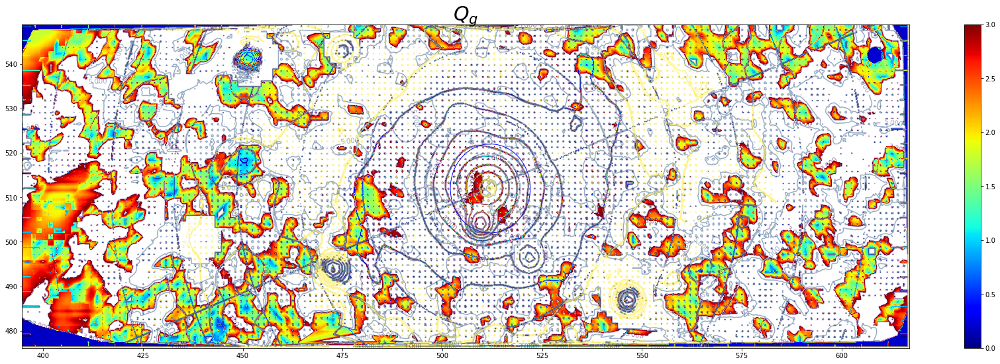

In [148]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()

CS = plt.contour(X, Y, Qeff_min, levels=[3., 5., 10.], aspect='auto', alpha=0.5)
plt.clabel(CS, inline=1, fontsize=10)

plt.title(r'$Q_g$', fontsize=30)

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)

<a list of 61 text.Text objects>

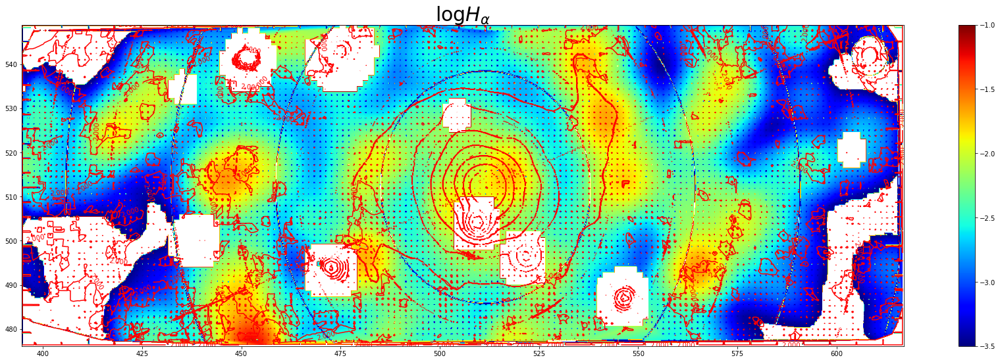

In [158]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])

# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-3.5, vmax=-1.)
plt.colorbar()
plt.title(r'$\log H_{\alpha}$', fontsize=30)

CS = plt.contour(X, Y, Qeff_min, levels=[2.0], colors=('red'))
plt.clabel(CS, inline=1, fontsize=10)

# X,Y = np.meshgrid(np.arange(0.,len(c_g),1), np.arange(0.,len(c_g[0]),1))
# CS = plt.contour(X[470:560, 380:650], Y[470:560, 380:650], c_g[470:560, 380:650], levels=[5., 10., 20.], aspect='auto', alpha=0.5)

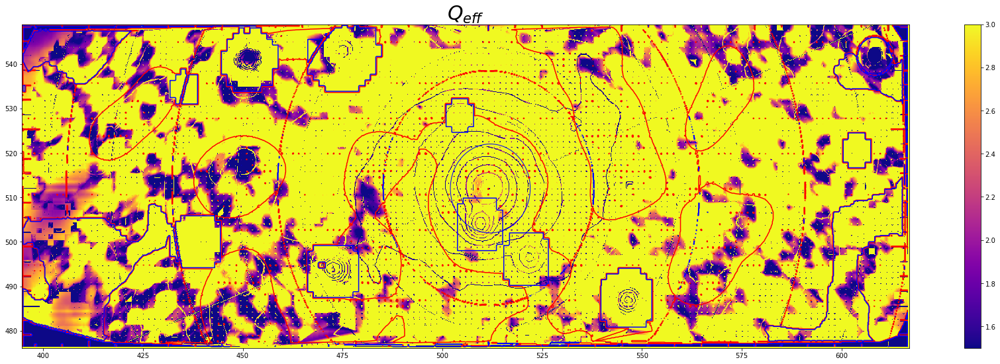

In [164]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.plasma)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=1.5, vmax=3.)
plt.colorbar()

plt.title(r'$Q_{eff}$', fontsize=30)

CS = plt.contour(X, Y, log_Halpha_SFR_, levels=[-2.25, -1.], colors=('red', 'blue'))

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)

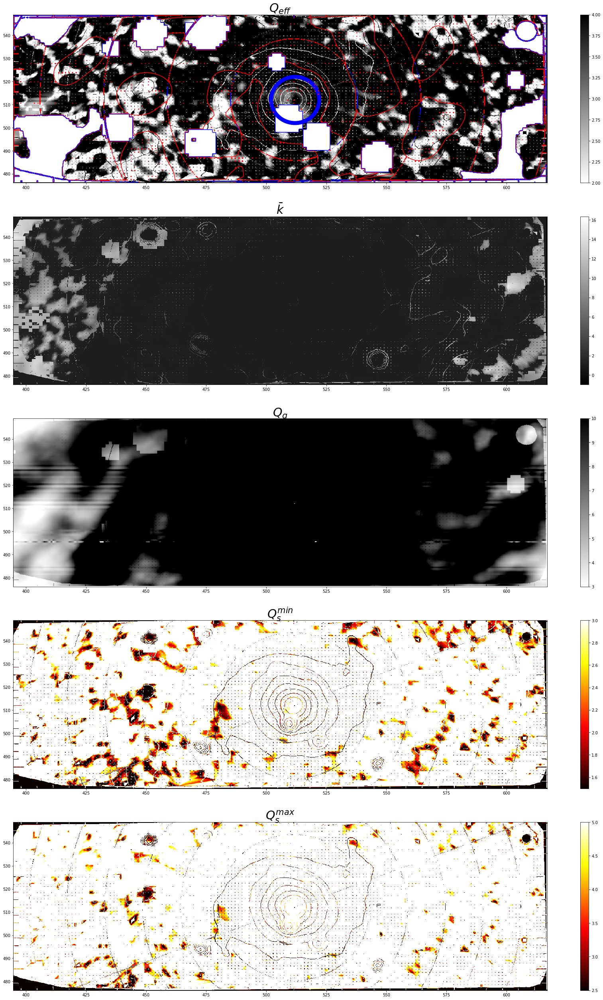

In [7]:
Image('tmp.png')